# Import libraries

In [ ]:
%tensorflow_version 2.x
from tensorflow import keras
from keras.layers import Dense,Conv2D,Flatten,MaxPool2D,Dropout,BatchNormalization, Input
from tensorflow.keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from keras import callbacks
from keras.models import Model

from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array

import pandas as pd
import numpy as np
import os
import gdown

from zipfile import ZipFile
import matplotlib.pyplot as plt

# We install the FER() library to perform facial recognition
# This installation will also take care of any of the above dependencies if they are missing
#!pip install FER

In [ ]:
#!pip install tf-nightly

# Conexion con Drive y carga de dataframe de atributos

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
dir="/content/drive/MyDrive/TFG/"

## Obtener anotaciones

In [ ]:
def get_annotation(fnmtxt, verbose=True):
  if verbose:
      print("_" * 70)
      #print(dir +"/"+ fnmtxt)

  #rfile = open(dir+"/"+fnmtxt, 'r')
  rfile = open(fnmtxt, 'r')
  texts = rfile.read().split("\n")
  rfile.close()

  columns = np.array(texts[1].split(" "))
  columns = columns[columns != ""]
  df = []
  for txt in texts[2:]:
      txt = np.array(txt.split(" "))
      txt = txt[txt != ""]

      df.append(txt)

  df = pd.DataFrame(df)

  if df.shape[1] == len(columns) + 1:
      columns = ["image_id"] + list(columns)
  df.columns = columns
  df = df.dropna()
  if verbose:
      print(" Total number of annotations {}\n".format(df.shape))
      print(df.head())
  ## cast to integer
  for nm in df.columns:
      if nm != "image_id":
          df[nm] = pd.to_numeric(df[nm], downcast="float")
  return (df)

attr   = get_annotation(dir+"list_attr_celeba.txt")
align  = get_annotation(dir+"list_landmarks_align_celeba.txt")

#assert np.all(align["image_id"] == attr["image_id"])

______________________________________________________________________
 Total number of annotations (202599, 41)

     image_id 5_o_Clock_Shadow Arched_Eyebrows Attractive Bags_Under_Eyes  \
0  000001.jpg               -1               1          1              -1   
1  000002.jpg               -1              -1         -1               1   
2  000003.jpg               -1              -1         -1              -1   
3  000004.jpg               -1              -1          1              -1   
4  000005.jpg               -1               1          1              -1   

  Bald Bangs Big_Lips Big_Nose Black_Hair  ... Sideburns Smiling  \
0   -1    -1       -1       -1         -1  ...        -1       1   
1   -1    -1       -1        1         -1  ...        -1       1   
2   -1    -1        1       -1         -1  ...        -1      -1   
3   -1    -1       -1       -1         -1  ...        -1      -1   
4   -1    -1        1       -1         -1  ...        -1      -1   

  Straight_Hai

In [ ]:
attr[['Black_Hair', 'Brown_Hair', 'Gray_Hair', 'Blond_Hair' , 'image_id']][:15]

,Black_Hair,Brown_Hair,Gray_Hair,Blond_Hair,image_id
0,-1.0,1.0,-1.0,-1.0,000001.jpg
1,-1.0,1.0,-1.0,-1.0,000002.jpg
2,-1.0,-1.0,-1.0,-1.0,000003.jpg
3,-1.0,-1.0,-1.0,-1.0,000004.jpg
4,-1.0,-1.0,-1.0,-1.0,000005.jpg
5,-1.0,1.0,-1.0,-1.0,000006.jpg
6,1.0,-1.0,-1.0,-1.0,000007.jpg
7,1.0,-1.0,-1.0,-1.0,000008.jpg
8,-1.0,-1.0,-1.0,-1.0,000009.jpg
9,-1.0,-1.0,-1.0,-1.0,000010.jpg


In [ ]:
dir_data = r"/content/drive/MyDrive/img_align_celeba.zip"
dir_output=r"/content/drive/MyDrive/TFG/celeba/img_align_celeba/"

import shutil

shutil.copyfile(dir_data, dir_output+"img_align_celeba.zip")

'/content/drive/MyDrive/TFG/celeba/img_align_celeba/img_align_celeba.zip'

In [ ]:
dir_output_local = r"/content/celeba/"
with ZipFile(dir_data, "r") as zipobj:
    zipobj.extractall(dir_output_local)

In [ ]:
dir= "/content/drive/MyDrive/TFG/"
celeba_annotations_facial_exp = np.empty((0,2),int)
for i in range(1,3,1):
  celeba_annotations_facial_exp = np.append(celeba_annotations_facial_exp, np.load(f'{dir}estimated_facial_expressions_{i}.npz', allow_pickle=True)['arr_0'], axis=0)

In [ ]:
celeba_annotations_facial_exp

array([['000001.jpg',
        {'angry': 5.81176516044606e-14, 'disgust': 1.3143771696238857e-19, 'fear': 5.046025446445168e-11, 'happy': 99.99551773071289, 'sad': 4.904584984671834e-10, 'surprise': 1.8425981226921628e-09, 'neutral': 0.004487036494538188}],
       ['000002.jpg',
        {'angry': 5.18898124468592e-07, 'disgust': 1.319865598129617e-15, 'fear': 5.161797204944474e-10, 'happy': 97.66042828559875, 'sad': 7.136162327725515e-07, 'surprise': 1.3217341177096387e-05, 'neutral': 2.339562401175499}],
       ['000003.jpg',
        {'angry': 7.715348154306412, 'disgust': 0.009655892790760845, 'fear': 9.597587585449219, 'happy': 0.30413318891078234, 'sad': 36.09423339366913, 'surprise': 7.528483365604188e-05, 'neutral': 46.27896845340729}],
       ...,
       ['055046.jpg',
        {'angry': 2.8167844186086155, 'disgust': 0.00023988956723514516, 'fear': 5.3210449581092645, 'happy': 1.652617369280175, 'sad': 6.003656640212936, 'surprise': 0.06784107309425495, 'neutral': 84.137811167501

In [ ]:
celeba_annotations_facial_exp[:, 1:2].flatten()

array([{'angry': 5.81176516044606e-14, 'disgust': 1.3143771696238857e-19, 'fear': 5.046025446445168e-11, 'happy': 99.99551773071289, 'sad': 4.904584984671834e-10, 'surprise': 1.8425981226921628e-09, 'neutral': 0.004487036494538188},
       {'angry': 5.18898124468592e-07, 'disgust': 1.319865598129617e-15, 'fear': 5.161797204944474e-10, 'happy': 97.66042828559875, 'sad': 7.136162327725515e-07, 'surprise': 1.3217341177096387e-05, 'neutral': 2.339562401175499},
       {'angry': 7.715348154306412, 'disgust': 0.009655892790760845, 'fear': 9.597587585449219, 'happy': 0.30413318891078234, 'sad': 36.09423339366913, 'surprise': 7.528483365604188e-05, 'neutral': 46.27896845340729},
       ...,
       {'angry': 2.8167844186086155, 'disgust': 0.00023988956723514516, 'fear': 5.3210449581092645, 'happy': 1.652617369280175, 'sad': 6.003656640212936, 'surprise': 0.06784107309425495, 'neutral': 84.13781116750107},
       {'angry': 2.9685599915909777, 'disgust': 0.36104352100419745, 'fear': 30.2805566453

In [ ]:
facial_expressions = {}
for k,v in zip(celeba_annotations_facial_exp[:, 0:1].flatten(), celeba_annotations_facial_exp[:, 1:2].flatten()):
  facial_expressions[k]= max(v, key=v.get)

In [ ]:
len(facial_expressions), facial_expressions.get('029711.jpg')

(55048, 'happy')

In [ ]:
attr["facial_expression"] = attr["image_id"].map(facial_expressions)

In [ ]:
attr

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young,facial_expression
0,000001.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,1.0,1.0,-1.0,1.0,-1.0,1.0,-1.0,-1.0,1.0,happy
1,000002.jpg,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,...,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,happy
2,000003.jpg,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,neutral
3,000004.jpg,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,1.0,-1.0,1.0,-1.0,1.0,1.0,-1.0,1.0,sad
4,000005.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,1.0,sad
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202594,202595.jpg,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,1.0,NaN
202595,202596.jpg,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,1.0,-1.0,-1.0,...,1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,NaN
202596,202597.jpg,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,...,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,NaN
202597,202598.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,1.0,...,1.0,-1.0,1.0,1.0,-1.0,1.0,-1.0,-1.0,1.0,NaN


## One hot

In [ ]:
# Get one hot encoding of columns B
one_hot = pd.get_dummies(attr['facial_expression'])
# Drop column B as it is now encoded
attr = attr.drop('facial_expression',axis = 1)
# Join the encoded df
attr = attr.join(one_hot)
attr  

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Wearing_Necklace,Wearing_Necktie,Young,angry,disgust,fear,happy,neutral,sad,surprise
0,000001.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,1.0,0,0,0,1,0,0,0
1,000002.jpg,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,...,-1.0,-1.0,1.0,0,0,0,1,0,0,0
2,000003.jpg,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,-1.0,1.0,0,0,0,0,1,0,0
3,000004.jpg,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,1.0,-1.0,1.0,0,0,0,0,0,1,0
4,000005.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,-1.0,1.0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202594,202595.jpg,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,-1.0,1.0,0,0,0,0,0,0,0
202595,202596.jpg,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,1.0,-1.0,-1.0,...,-1.0,-1.0,1.0,0,0,0,0,0,0,0
202596,202597.jpg,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,...,-1.0,-1.0,1.0,0,0,0,0,0,0,0
202597,202598.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,1.0,...,-1.0,-1.0,1.0,0,0,0,0,0,0,0


In [ ]:
celeba_annotations_age = np.empty((0,2),int)
for i in range(1,5,1):
  celeba_annotations_age = np.append(celeba_annotations_age, np.load(f'{dir}estimated_ages_with_image_id_{i}.npz', allow_pickle=True)['arr_0'], axis=0)

In [ ]:
len(celeba_annotations_age), len(facial_expressions)

(57308, 55048)

In [ ]:
zipped = zip(celeba_annotations_age[:, 0:1].flatten(),celeba_annotations_age[:, 1:2].flatten())
dict_map = {k:v for k,v in zipped}

In [ ]:
attr["predicted_age"] = attr["image_id"].map(dict_map)

In [ ]:
attr.head()

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Wearing_Necktie,Young,angry,disgust,fear,happy,neutral,sad,surprise,predicted_age
0,000001.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,1.0,0,0,0,1,0,0,0,36
1,000002.jpg,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,...,-1.0,1.0,0,0,0,1,0,0,0,32
2,000003.jpg,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,1.0,0,0,0,0,1,0,0,33
3,000004.jpg,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,1.0,0,0,0,0,0,1,0,30
4,000005.jpg,-1.0,1.0,1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,...,-1.0,1.0,0,0,0,0,0,1,0,30


In [ ]:
attr.columns

Index(['image_id', '5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive',
       'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose',
       'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows',
       'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair',
       'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open',
       'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin',
       'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns',
       'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings',
       'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace',
       'Wearing_Necktie', 'Young', 'angry', 'disgust', 'fear', 'happy',
       'neutral', 'sad', 'surprise', 'predicted_age'],
      dtype='object')

# Modelo tipo A y procesamiento de datos

In [ ]:
from keras.models import Sequential
"""Import from keras_preprocessing not from keras.preprocessing, because Keras may or maynot contain the features discussed here depending upon when you read this article, until the keras_preprocessed library is updated in Keras use the github version."""
from keras_preprocessing.image import ImageDataGenerator
from keras.layers import Dense, Activation, Flatten, Dropout, BatchNormalization
from keras.layers import Conv2D, MaxPooling2D
from keras import regularizers, optimizers
import pandas as pd
import numpy as np

In [ ]:
dir_images = '/content/celeba/img_align_celeba/'

In [ ]:
datagen=ImageDataGenerator(rescale=1./255.)
test_datagen=ImageDataGenerator(rescale=1./255.)

In [ ]:
attr.columns

In [ ]:
df = attr[['image_id','Male', 'angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']]

In [ ]:
df['Male'] = df['Male'].replace([-1.0],0)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df

,image_id,Male,angry,disgust,fear,happy,neutral,sad,surprise
0,000001.jpg,0.0,0,0,0,1,0,0,0
1,000002.jpg,0.0,0,0,0,1,0,0,0
2,000003.jpg,1.0,0,0,0,0,1,0,0
3,000004.jpg,0.0,0,0,0,0,0,1,0
4,000005.jpg,0.0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...
202594,202595.jpg,0.0,0,0,0,0,0,0,0
202595,202596.jpg,1.0,0,0,0,0,0,0,0
202596,202597.jpg,1.0,0,0,0,0,0,0,0
202597,202598.jpg,0.0,0,0,0,0,0,0,0


In [ ]:
df = pd.get_dummies(df, columns = ['Male'])

In [ ]:
df = df.rename(columns={'Male_0.0': 'Female', 'Male_1.0': 'Male'})

In [ ]:
df

,image_id,angry,disgust,fear,happy,neutral,sad,surprise,Female,Male
0,000001.jpg,0,0,0,1,0,0,0,1,0
1,000002.jpg,0,0,0,1,0,0,0,1,0
2,000003.jpg,0,0,0,0,1,0,0,0,1
3,000004.jpg,0,0,0,0,0,1,0,1,0
4,000005.jpg,0,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...
202594,202595.jpg,0,0,0,0,0,0,0,1,0
202595,202596.jpg,0,0,0,0,0,0,0,0,1
202596,202597.jpg,0,0,0,0,0,0,0,0,1
202597,202598.jpg,0,0,0,0,0,0,0,1,0


In [ ]:
columns = df.columns

In [ ]:
HEIGHT = 178
WIDTH = 218

In [ ]:
len(facial_expressions)

55048

In [ ]:
int(len(facial_expressions)*0.7), int(len(facial_expressions)*0.1), int(len(facial_expressions)*0.2)

(38533, 5504, 11009)

In [ ]:
train_per= int(len(facial_expressions)*0.7)
validate_per=int(len(facial_expressions)*0.1)
test_per=int(len(facial_expressions)*0.2)

In [ ]:
(train_per+validate_per)+test_per

55046

In [ ]:
#max_rows=(train_per+validate_per)+test_per
#df=df[:max_rows]

In [ ]:
#df.tail()
columns

Index(['image_id', 'angry', 'disgust', 'fear', 'happy', 'neutral', 'sad',
       'surprise', 'Female', 'Male'],
      dtype='object')

In [ ]:
columns

Index(['image_id', 'angry', 'disgust', 'fear', 'happy', 'neutral', 'sad',
       'surprise', 'Female', 'Male'],
      dtype='object')

In [ ]:
y_columns = [c for c in columns if c!='image_id']
y_columns

['angry',
 'disgust',
 'fear',
 'happy',
 'neutral',
 'sad',
 'surprise',
 'Female',
 'Male']

In [ ]:
train_generator=datagen.flow_from_dataframe(
dataframe=df[:train_per],
directory=dir_images,
x_col="image_id",
y_col=y_columns,
batch_size=32,
seed=42,
shuffle=True,
class_mode="raw",
target_size=(WIDTH, HEIGHT))

Found 38533 validated image filenames.


In [ ]:
valid_generator=test_datagen.flow_from_dataframe(
dataframe=df[train_per:train_per+validate_per],
directory=dir_images,
x_col="image_id",
y_col=y_columns,
batch_size=32,
seed=42,
shuffle=True,
class_mode="raw",
target_size=(WIDTH, HEIGHT))

Found 5504 validated image filenames.


In [ ]:
test_generator=test_datagen.flow_from_dataframe(
dataframe=df[train_per+validate_per:(train_per+validate_per)+test_per],
directory=dir_images,
x_col="image_id",
batch_size=1,
seed=42,
shuffle=False,
class_mode=None,
target_size=(WIDTH, HEIGHT))

Found 11009 validated image filenames.


In [ ]:
df.columns, len(df.columns)

(Index(['image_id', 'angry', 'disgust', 'fear', 'happy', 'neutral', 'sad',
        'surprise', 'Female', 'Male'],
       dtype='object'), 10)

In [ ]:
from tensorflow.keras import optimizers

In [ ]:
inp = Input(shape = (WIDTH,HEIGHT,3))
x = Conv2D(32, (3, 3), padding = 'same')(inp)
x = Activation('relu')(x)
x = Conv2D(32, (3, 3))(x)
x = Activation('relu')(x)
x = MaxPooling2D(pool_size = (2, 2))(x)
x = Dropout(0.25)(x)
x = Conv2D(64, (3, 3), padding = 'same')(x)
x = Activation('relu')(x)
x = Conv2D(64, (3, 3))(x)
x = Activation('relu')(x)
x = MaxPooling2D(pool_size = (2, 2))(x)
x = Dropout(0.25)(x)
x = Flatten()(x)
x = Dense(512)(x)
x = Activation('relu')(x)
x = Dropout(0.5)(x)
output1 = Dense(1, activation = 'sigmoid')(x)
output2 = Dense(1, activation = 'sigmoid')(x)
output3 = Dense(1, activation = 'sigmoid')(x)
output4 = Dense(1, activation = 'sigmoid')(x)
output5 = Dense(1, activation = 'sigmoid')(x)
output6 = Dense(1, activation = 'sigmoid')(x)
output7 = Dense(1, activation = 'sigmoid')(x)
output8 = Dense(1, activation = 'sigmoid')(x)
output9 = Dense(1, activation = 'sigmoid')(x)
model = Model(inp,[output1,output2,output3,output4,output5,output6,output7,output8,output9])
model.compile(optimizers.RMSprop(lr = 0.0001, decay = 1e-6),
loss = ["binary_crossentropy","binary_crossentropy", "binary_crossentropy","binary_crossentropy", "binary_crossentropy",
        "binary_crossentropy","binary_crossentropy", "binary_crossentropy","binary_crossentropy"],
metrics = ["accuracy"])

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


In [ ]:
def generator_wrapper(generator, num_outputs):
    for batch_x,batch_y in generator:
        yield (batch_x,[batch_y[:,i] for i in range(num_outputs)])

In [ ]:
num_outputs=len(y_columns)

In [ ]:
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=valid_generator.n//valid_generator.batch_size
STEP_SIZE_TEST=test_generator.n//test_generator.batch_size
model.fit_generator(generator=generator_wrapper(train_generator, num_outputs),
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data= generator_wrapper(valid_generator,num_outputs),
                    validation_steps=STEP_SIZE_VALID,
                    epochs=1,verbose=2)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  


1204/1204 - 212s - loss: 2.4452 - dense_47_loss: 0.1800 - dense_48_loss: 0.0281 - dense_49_loss: 0.2598 - dense_50_loss: 0.4528 - dense_51_loss: 0.5345 - dense_52_loss: 0.3214 - dense_53_loss: 0.0736 - dense_54_loss: 0.2993 - dense_55_loss: 0.2958 - dense_47_accuracy: 0.9524 - dense_48_accuracy: 0.9966 - dense_49_accuracy: 0.9256 - dense_50_accuracy: 0.7871 - dense_51_accuracy: 0.7215 - dense_52_accuracy: 0.8819 - dense_53_accuracy: 0.9863 - dense_54_accuracy: 0.8698 - dense_55_accuracy: 0.8718 - val_loss: 1.8938 - val_dense_47_loss: 0.1576 - val_dense_48_loss: 0.0323 - val_dense_49_loss: 0.2360 - val_dense_50_loss: 0.3586 - val_dense_51_loss: 0.4645 - val_dense_52_loss: 0.2777 - val_dense_53_loss: 0.0566 - val_dense_54_loss: 0.1575 - val_dense_55_loss: 0.1528 - val_dense_47_accuracy: 0.9568 - val_dense_48_accuracy: 0.9953 - val_dense_49_accuracy: 0.9250 - val_dense_50_accuracy: 0.8476 - val_dense_51_accuracy: 0.7564 - val_dense_52_accuracy: 0.8923 - val_dense_53_accuracy: 0.9889 - val

In [ ]:
test_generator.reset()
pred=model.predict_generator(test_generator,
steps=STEP_SIZE_TEST,
verbose=1)

    1/11009 [..............................] - ETA: 25:13

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  after removing the cwd from sys.path.


11009/11009 [==============================] - 42s 4ms/step


In [ ]:
np.shape(pred)

(9, 11009, 1)

In [ ]:
len(pred), len(pred[0]), len(pred[1]), len(pred[2]), len(pred[3]),len(pred[4])

(9, 11009, 11009, 11009, 11009, 11009)

In [ ]:
model

In [ ]:
from keras.callbacks import ModelCheckpoint
batch_size = 32
valid_batch_size = 32
epochs = 4
callbacks = [
    ModelCheckpoint("./model_checkpoint", monitor='val_loss')
]
history = model.fit(generator_wrapper(train_generator,num_outputs),
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    callbacks=callbacks,
                    validation_data= generator_wrapper(valid_generator,num_outputs),
                    validation_steps=STEP_SIZE_VALID,
                    epochs=epochs,verbose=2)

INFO:tensorflow:Assets written to: ./model_checkpoint/assets
1204/1204 - 163s - loss: 2.4253 - dense_57_loss: 0.1833 - dense_58_loss: 0.0299 - dense_59_loss: 0.2624 - dense_60_loss: 0.4337 - dense_61_loss: 0.5259 - dense_62_loss: 0.3199 - dense_63_loss: 0.0735 - dense_64_loss: 0.3014 - dense_65_loss: 0.2953 - dense_57_accuracy: 0.9513 - dense_58_accuracy: 0.9959 - dense_59_accuracy: 0.9245 - dense_60_accuracy: 0.7987 - dense_61_accuracy: 0.7256 - dense_62_accuracy: 0.8822 - dense_63_accuracy: 0.9860 - dense_64_accuracy: 0.8690 - dense_65_accuracy: 0.8714 - val_loss: 1.8453 - val_dense_57_loss: 0.1573 - val_dense_58_loss: 0.0326 - val_dense_59_loss: 0.2444 - val_dense_60_loss: 0.3241 - val_dense_61_loss: 0.4522 - val_dense_62_loss: 0.2807 - val_dense_63_loss: 0.0554 - val_dense_64_loss: 0.1523 - val_dense_65_loss: 0.1462 - val_dense_57_accuracy: 0.9566 - val_dense_58_accuracy: 0.9953 - val_dense_59_accuracy: 0.9239 - val_dense_60_accuracy: 0.8650 - val_dense_61_accuracy: 0.7680 - val_de

In [ ]:
import numpy as np 
import pandas as pd
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

In [ ]:
history.history

{'dense_57_accuracy': [0.9512999653816223],
 'dense_57_loss': [0.1833491027355194],
 'dense_58_accuracy': [0.9958962202072144],
 'dense_58_loss': [0.02987707406282425],
 'dense_59_accuracy': [0.9245214462280273],
 'dense_59_loss': [0.2624315321445465],
 'dense_60_accuracy': [0.7986545562744141],
 'dense_60_loss': [0.43365463614463806],
 'dense_61_accuracy': [0.7255915403366089],
 'dense_61_loss': [0.5259410738945007],
 'dense_62_accuracy': [0.8821848630905151],
 'dense_62_loss': [0.3199234902858734],
 'dense_63_accuracy': [0.9860263466835022],
 'dense_63_loss': [0.07349222898483276],
 'dense_64_accuracy': [0.868964433670044],
 'dense_64_loss': [0.30138951539993286],
 'dense_65_accuracy': [0.8714318871498108],
 'dense_65_loss': [0.29527634382247925],
 'loss': [2.4253368377685547],
 'val_dense_57_accuracy': [0.9565770626068115],
 'val_dense_57_loss': [0.15731637179851532],
 'val_dense_58_accuracy': [0.995276153087616],
 'val_dense_58_loss': [0.03264876455068588],
 'val_dense_59_accuracy'

In [ ]:
plt.clf()
fig = go.Figure()
fig.add_trace(go.Scatter(
                    y=history.history['dense_64_accuracy'],
                    name='Train'))
fig.add_trace(go.Scatter(
                    y=history.history['val_dense_64_accuracy'],
                    name='Valid'))
fig.update_layout(height=500, 
                  width=700,
                  title='Accuracy for race feature',
                  xaxis_title='Epoch',
                  yaxis_title='Accuracy')
fig.show()

<Figure size 432x288 with 0 Axes>

In [ ]:
# Second version

# Modelo tipo B y procesamiento

In [ ]:
max_rows=len(facial_expressions)

In [ ]:
df = attr[['image_id','Male', 'angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise','predicted_age']]

In [ ]:
df= df[:max_rows]

In [ ]:
df

,image_id,Male,angry,disgust,fear,happy,neutral,sad,surprise,predicted_age
0,000001.jpg,-1.0,0,0,0,1,0,0,0,36
1,000002.jpg,-1.0,0,0,0,1,0,0,0,32
2,000003.jpg,1.0,0,0,0,0,1,0,0,33
3,000004.jpg,-1.0,0,0,0,0,0,1,0,30
4,000005.jpg,-1.0,0,0,0,0,0,1,0,30
...,...,...,...,...,...,...,...,...,...,...
55043,055044.jpg,-1.0,0,0,0,1,0,0,0,30
55044,055045.jpg,1.0,0,0,0,0,0,1,0,35
55045,055046.jpg,-1.0,0,0,0,0,1,0,0,27
55046,055047.jpg,1.0,0,0,0,0,0,0,1,46


In [ ]:
df['Male'] = df['Male'].replace([-1.0],0)
df = pd.get_dummies(df, columns = ['Male'])
df = df.rename(columns={'Male_0.0': 'Female', 'Male_1.0': 'Male'})

In [ ]:
df

,image_id,angry,disgust,fear,happy,neutral,sad,surprise,predicted_age,Female,Male
0,000001.jpg,0,0,0,1,0,0,0,36,1,0
1,000002.jpg,0,0,0,1,0,0,0,32,1,0
2,000003.jpg,0,0,0,0,1,0,0,33,0,1
3,000004.jpg,0,0,0,0,0,1,0,30,1,0
4,000005.jpg,0,0,0,0,0,1,0,30,1,0
...,...,...,...,...,...,...,...,...,...,...,...
55043,055044.jpg,0,0,0,1,0,0,0,30,1,0
55044,055045.jpg,0,0,0,0,0,1,0,35,0,1
55045,055046.jpg,0,0,0,0,1,0,0,27,1,0
55046,055047.jpg,0,0,0,0,0,0,1,46,0,1


In [ ]:
df['gender']=pd.get_dummies(df[['Female','Male']]).idxmax(1)

In [ ]:
df

,image_id,angry,disgust,fear,happy,neutral,sad,surprise,predicted_age,Female,Male,gender
0,000001.jpg,0,0,0,1,0,0,0,36,1,0,Female
1,000002.jpg,0,0,0,1,0,0,0,32,1,0,Female
2,000003.jpg,0,0,0,0,1,0,0,33,0,1,Male
3,000004.jpg,0,0,0,0,0,1,0,30,1,0,Female
4,000005.jpg,0,0,0,0,0,1,0,30,1,0,Female
...,...,...,...,...,...,...,...,...,...,...,...,...
55043,055044.jpg,0,0,0,1,0,0,0,30,1,0,Female
55044,055045.jpg,0,0,0,0,0,1,0,35,0,1,Male
55045,055046.jpg,0,0,0,0,1,0,0,27,1,0,Female
55046,055047.jpg,0,0,0,0,0,0,1,46,0,1,Male


In [ ]:
df['expression']=pd.get_dummies(df[['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']]).idxmax(1)

In [ ]:
df

,image_id,angry,disgust,fear,happy,neutral,sad,surprise,predicted_age,Female,Male,gender,expression
0,000001.jpg,0,0,0,1,0,0,0,36,1,0,Female,happy
1,000002.jpg,0,0,0,1,0,0,0,32,1,0,Female,happy
2,000003.jpg,0,0,0,0,1,0,0,33,0,1,Male,neutral
3,000004.jpg,0,0,0,0,0,1,0,30,1,0,Female,sad
4,000005.jpg,0,0,0,0,0,1,0,30,1,0,Female,sad
...,...,...,...,...,...,...,...,...,...,...,...,...,...
55043,055044.jpg,0,0,0,1,0,0,0,30,1,0,Female,happy
55044,055045.jpg,0,0,0,0,0,1,0,35,0,1,Male,sad
55045,055046.jpg,0,0,0,0,1,0,0,27,1,0,Female,neutral
55046,055047.jpg,0,0,0,0,0,0,1,46,0,1,Male,surprise


In [ ]:
df= df.drop(['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise','Female','Male'], axis=1)

In [ ]:
df

,image_id,predicted_age,gender,expression
0,000001.jpg,36,Female,happy
1,000002.jpg,32,Female,happy
2,000003.jpg,33,Male,neutral
3,000004.jpg,30,Female,sad
4,000005.jpg,30,Female,sad
...,...,...,...,...
55043,055044.jpg,30,Female,happy
55044,055045.jpg,35,Male,sad
55045,055046.jpg,27,Female,neutral
55046,055047.jpg,46,Male,surprise


In [ ]:
df["gender"] = np.where(df["gender"] == 'Female', 1, 0)

In [ ]:
df.head()

,image_id,predicted_age,gender,expression
0,000001.jpg,36,1,happy
1,000002.jpg,32,1,happy
2,000003.jpg,33,0,neutral
3,000004.jpg,30,1,sad
4,000005.jpg,30,1,sad


In [ ]:
df.columns

Index(['image_id', 'predicted_age', 'gender', 'expression'], dtype='object')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55048 entries, 0 to 55047
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   image_id       55048 non-null  object
 1   predicted_age  55048 non-null  object
 2   gender         55048 non-null  int64 
 3   expression     55048 non-null  object
dtypes: int64(1), object(3)
memory usage: 2.1+ MB


In [ ]:
df['predicted_age'] = df['predicted_age'].astype(np.int16)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55048 entries, 0 to 55047
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   image_id       55048 non-null  object
 1   predicted_age  55048 non-null  int16 
 2   gender         55048 non-null  int64 
 3   expression     55048 non-null  object
dtypes: int16(1), int64(1), object(2)
memory usage: 1.8+ MB


In [ ]:
df.head()

,image_id,predicted_age,gender,expression
0,000001.jpg,36,1,happy
1,000002.jpg,32,1,happy
2,000003.jpg,33,0,neutral
3,000004.jpg,30,1,sad
4,000005.jpg,30,1,sad


# Corregir sad


In [ ]:
df.loc[df.expression=='sad']

,image_id,predicted_age,gender,expression,gender_id,expression_id
3,000004.jpg,30,1,sad,1,5
4,000005.jpg,30,1,sad,1,5
19,000020.jpg,41,0,sad,0,5
31,000032.jpg,49,0,sad,0,5
55,000056.jpg,24,0,sad,0,5
...,...,...,...,...,...,...
54990,054991.jpg,34,0,sad,0,5
54995,054996.jpg,36,1,sad,1,5
55009,055010.jpg,42,0,sad,0,5
55038,055039.jpg,33,1,sad,1,5


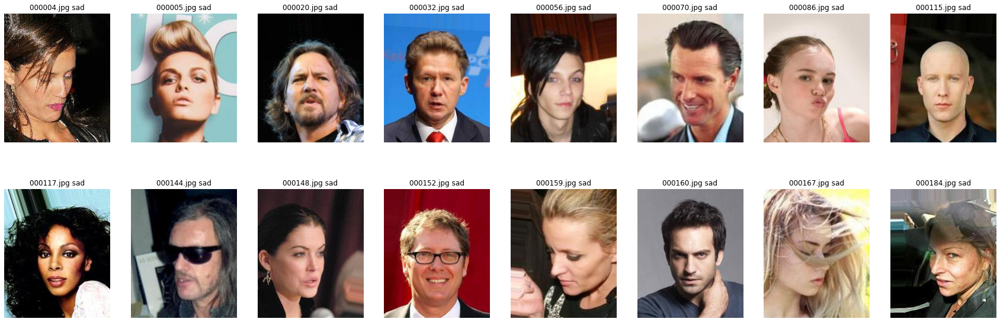

In [ ]:
dir_data='/content/celeba/img_align_celeba'

num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)
for index, row in df.loc[df.expression=='sad'][:16].reset_index().iterrows():
    rows = 2
    cols=8
    image = load_img(dir_data + "/" + row.image_id)
    image = img_to_array(image)/255.0
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.title(row.image_id+' '+row.expression)
    plt.imshow(image) 

[{'box': array([52, 85, 80, 80], dtype=int32), 'emotions': {'angry': 0.02, 'disgust': 0.0, 'fear': 0.02, 'happy': 0.27, 'sad': 0.01, 'surprise': 0.0, 'neutral': 0.67}}, {'box': array([ 33, 124,  81,  81], dtype=int32), 'emotions': {'angry': 0.15, 'disgust': 0.0, 'fear': 0.03, 'happy': 0.11, 'sad': 0.56, 'surprise': 0.01, 'neutral': 0.14}}]
neutral 0.67
neutral


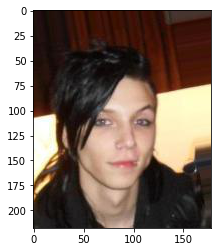

In [ ]:
from fer import FER

test_image_one = plt.imread(dir_data+"/000056.jpg")
#emo_detector = FER(mtcnn=True)
emo_detector = FER()
# Capture all the emotions on the image
captured_emotions = emo_detector.detect_emotions(test_image_one)
# Print all captured emotions with the image
print(captured_emotions)
plt.imshow(test_image_one)

# Use the top Emotion() function to call for the dominant emotion in the image
dominant_emotion, emotion_score = emo_detector.top_emotion(test_image_one)
print(dominant_emotion, emotion_score)

if captured_emotions and dominant_emotion!='sad':
  if abs(emotion_score - captured_emotions[0]['emotions']['sad']) <=0.09:
    print(row.expression)
  else:
    print(dominant_emotion)
else:
  print(row.expression)

In [ ]:
captured_emotions[0]['emotions']['sad']

0.0

In [ ]:
wi

In [ ]:
abs(0.68 - 0.58)

0.10000000000000009

In [ ]:
df_corrected_sad= df.loc[df.expression=='sad'].copy()
df_corrected_sad['expression']= df_corrected_sad.apply(lambda x: correct_expression(x), axis = 1)
df_corrected_sad.head()

,image_id,predicted_age,gender,expression,gender_id,expression_id
3,000004.jpg,30,1,sad,1,5
4,000005.jpg,30,1,neutral,1,5
19,000020.jpg,41,0,angry,0,5
31,000032.jpg,49,0,angry,0,5
55,000056.jpg,24,0,neutral,0,5


In [ ]:
np.savez('df_corrected_sad.npz', df_corrected_sad)

In [ ]:
#merged = df.merge(df_corrected_sad, on=['image_id'], how='right')
merged=df_corrected_sad.combine_first(df)
merged[:20]
# ['image_id','predicted_age','gender','expression','gender_id']

,image_id,predicted_age,gender,expression,gender_id,expression_id
0,000001.jpg,36,1,happy,1,3
1,000002.jpg,32,1,happy,1,3
2,000003.jpg,33,0,neutral,0,4
3,000004.jpg,30,1,sad,1,5
4,000005.jpg,30,1,neutral,1,5
5,000006.jpg,31,1,neutral,1,4
6,000007.jpg,30,0,happy,0,3
7,000008.jpg,31,0,neutral,0,4
8,000009.jpg,42,1,happy,1,3
9,000010.jpg,33,1,happy,1,3


In [ ]:
np.savez('final_dataset_v1.npz', merged)

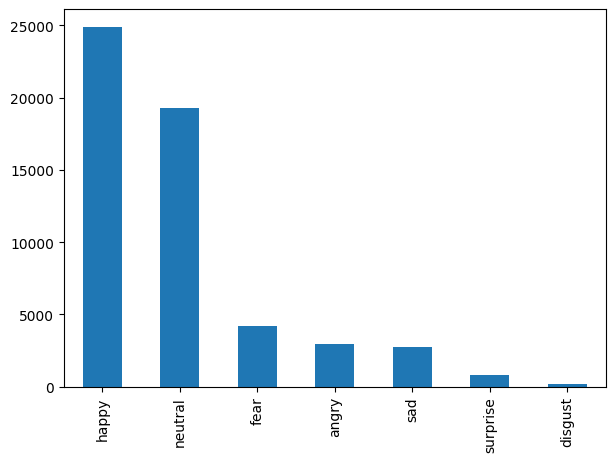

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
merged['expression'].value_counts().plot(kind='bar')

In [ ]:
np.savez('final_dataset_v1.npz', merged)

# Load saved corrected dataset

In [ ]:
corrected_dataset = np.load('/content/drive/MyDrive/TFG/final_dataset_v1_1.npz', allow_pickle=True)
df_v1=pd.DataFrame(corrected_dataset['arr_0'], columns=['image_id','predicted_age','gender','expression','gender_id', 'expression_id'])
df_v1.head()

,image_id,predicted_age,gender,expression,gender_id,expression_id
0,000001.jpg,36,1,happy,1,3
1,000002.jpg,32,1,happy,1,3
2,000003.jpg,33,0,neutral,0,4
3,000004.jpg,30,1,sad,1,5
4,000005.jpg,30,1,neutral,1,5


In [ ]:
df_v1.tail()

,image_id,predicted_age,gender,expression,gender_id,expression_id
55043,055044.jpg,30,1,happy,1,3
55044,055045.jpg,35,0,sad,0,5
55045,055046.jpg,27,1,neutral,1,4
55046,055047.jpg,46,0,surprise,0,6
55047,055048.jpg,28,1,neutral,1,4


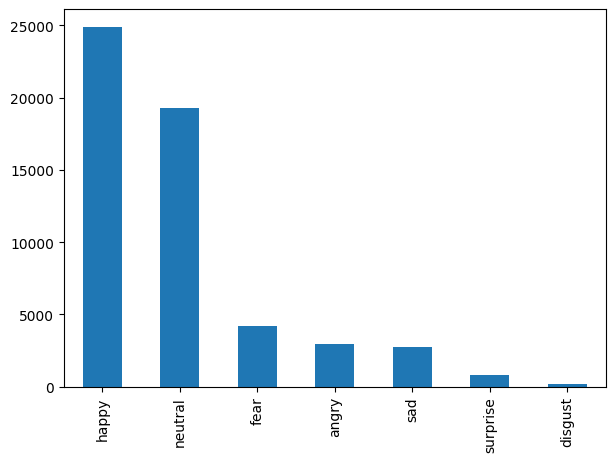

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
df_v1['expression'].value_counts().plot(kind='bar')

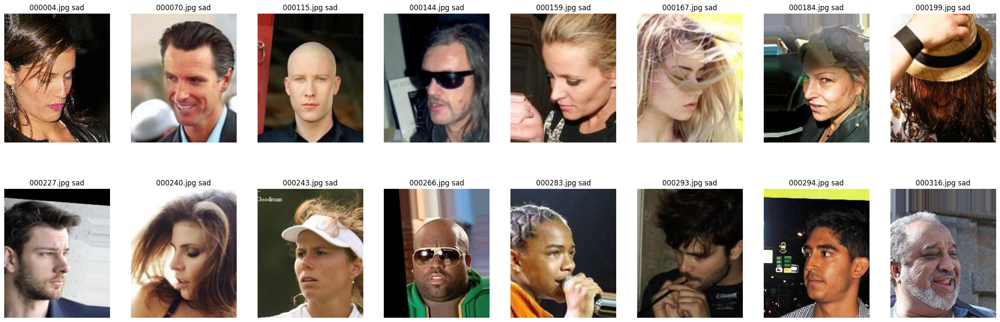

In [ ]:
dir_data='/content/celeba/img_align_celeba'

num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)
for index, row in df_v1.loc[df_v1.expression=='sad'][:16].reset_index().iterrows():
    rows = 2
    cols=8
    image = load_img(dir_data + "/" + row.image_id)
    image = img_to_array(image)/255.0
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.title(row.image_id+' '+row.expression)
    plt.imshow(image) 

In [ ]:
attr.columns

Index(['image_id', '5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive',
       'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose',
       'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows',
       'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair',
       'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open',
       'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin',
       'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns',
       'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings',
       'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace',
       'Wearing_Necktie', 'Young'],
      dtype='object')

In [ ]:
attr[['Black_Hair', 'Brown_Hair', 'Gray_Hair', 'Blond_Hair' , 'image_id']][:10]

,Black_Hair,Brown_Hair,Gray_Hair,Blond_Hair,image_id
0,-1.0,1.0,-1.0,-1.0,000001.jpg
1,-1.0,1.0,-1.0,-1.0,000002.jpg
2,-1.0,-1.0,-1.0,-1.0,000003.jpg
3,-1.0,-1.0,-1.0,-1.0,000004.jpg
4,-1.0,-1.0,-1.0,-1.0,000005.jpg
5,-1.0,1.0,-1.0,-1.0,000006.jpg
6,1.0,-1.0,-1.0,-1.0,000007.jpg
7,1.0,-1.0,-1.0,-1.0,000008.jpg
8,-1.0,-1.0,-1.0,-1.0,000009.jpg
9,-1.0,-1.0,-1.0,-1.0,000010.jpg


In [ ]:
attr.loc[attr.Black_Hair==1][['Black_Hair', 'Brown_Hair', 'Gray_Hair', 'Blond_Hair' ]][:10]

,Black_Hair,Brown_Hair,Gray_Hair,Blond_Hair
6,1.0,-1.0,-1.0,-1.0
7,1.0,-1.0,-1.0,-1.0
10,1.0,-1.0,-1.0,-1.0
11,1.0,-1.0,-1.0,-1.0
13,1.0,-1.0,-1.0,-1.0
16,1.0,-1.0,-1.0,-1.0
19,1.0,-1.0,-1.0,-1.0
26,1.0,-1.0,-1.0,-1.0
32,1.0,1.0,-1.0,-1.0
34,1.0,-1.0,-1.0,-1.0


In [ ]:
attr.loc[attr.Blond_Hair==1][['Black_Hair', 'Brown_Hair', 'Gray_Hair', 'Blond_Hair' ]][:10]

,Black_Hair,Brown_Hair,Gray_Hair,Blond_Hair
12,-1.0,-1.0,-1.0,1.0
17,-1.0,-1.0,-1.0,1.0
18,-1.0,-1.0,-1.0,1.0
21,-1.0,-1.0,-1.0,1.0
23,-1.0,-1.0,-1.0,1.0
28,-1.0,-1.0,-1.0,1.0
53,-1.0,-1.0,-1.0,1.0
70,-1.0,-1.0,-1.0,1.0
91,-1.0,-1.0,-1.0,1.0
93,-1.0,-1.0,1.0,1.0


In [ ]:
def unkown_hair_color(x):
  if x['Black_Hair'] != 1.0 and x['Brown_Hair'] != 1.0 and x['Gray_Hair'] != 1.0 and x['Blond_Hair']!= 1.0:
    return np.nan 
  else:
    return x.idxmax()


In [ ]:
#df_v1['hair_color'] = attr[['Black_Hair', 'Brown_Hair', 'Gray_Hair', 'Blond_Hair' ]].idxmax(axis=1)
df_v1['hair_color'] = attr[['Black_Hair', 'Brown_Hair', 'Gray_Hair', 'Blond_Hair' ]].apply(lambda x: unkown_hair_color(x), axis = 1)
df_v1[:14]

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000001.jpg,36,1,happy,1,3,Brown_Hair
1,000002.jpg,32,1,happy,1,3,Brown_Hair
2,000003.jpg,33,0,neutral,0,4,NaN
3,000004.jpg,30,1,sad,1,5,NaN
4,000005.jpg,30,1,neutral,1,5,NaN
5,000006.jpg,31,1,neutral,1,4,Brown_Hair
6,000007.jpg,30,0,happy,0,3,Black_Hair
7,000008.jpg,31,0,neutral,0,4,Black_Hair
8,000009.jpg,42,1,happy,1,3,NaN
9,000010.jpg,33,1,happy,1,3,NaN


In [ ]:
df_v1.tail()

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
55043,055044.jpg,30,1,happy,1,3,Black_Hair
55044,055045.jpg,35,0,sad,0,5,NaN
55045,055046.jpg,27,1,neutral,1,4,Blond_Hair
55046,055047.jpg,46,0,surprise,0,6,NaN
55047,055048.jpg,28,1,neutral,1,4,NaN


In [ ]:
df_v1['hair_color'].isna().sum()

21040

In [ ]:
len(df_v1)-df_v1['hair_color'].isna().sum()

34008

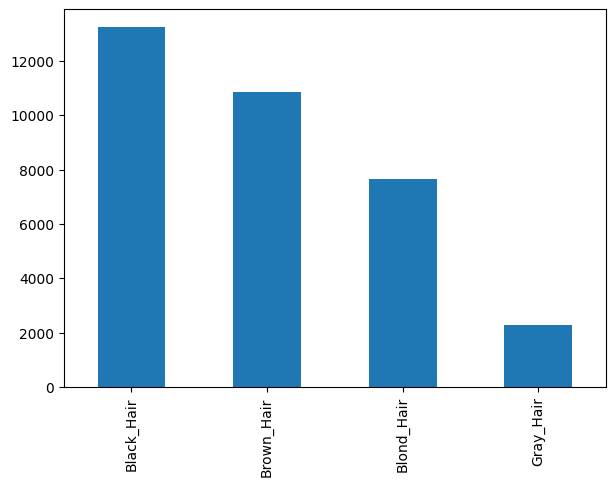

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
df_v1['hair_color'].value_counts().plot(kind='bar')

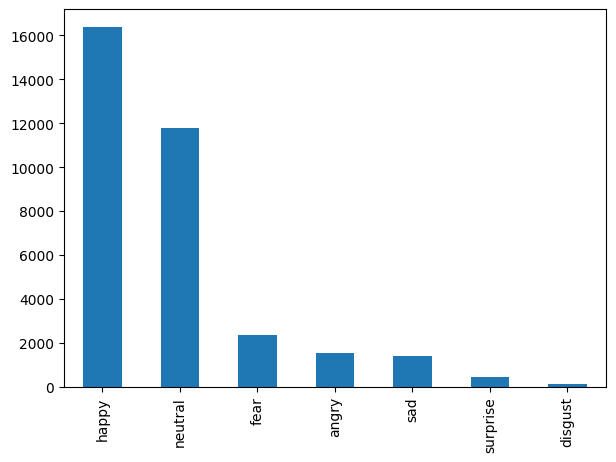

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
df_v1.loc[df_v1.hair_color.notnull()]['expression'].value_counts().plot(kind='bar')

In [ ]:
df_v1_no_null = df_v1.loc[df_v1.hair_color.notnull()]

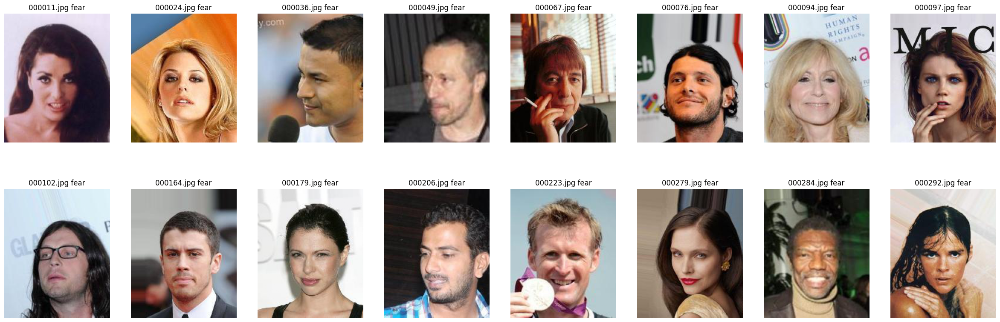

In [ ]:
dir_data='/content/celeba/img_align_celeba'

num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)
for index, row in df_v1_no_null.loc[df_v1_no_null.expression=='fear'][:16].reset_index().iterrows():
    rows = 2
    cols=8
    image = load_img(dir_data + "/" + row.image_id)
    image = img_to_array(image)/255.0
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.title(row.image_id+' '+row.expression)
    plt.imshow(image) 

In [ ]:
def correct_expression(row):
  from fer import FER
  test_image_one = plt.imread(dir_data+"/"+row['image_id'])
  #emo_detector = FER(mtcnn=True)
  emo_detector = FER()
  # Capture all the emotions on the image
  captured_emotions = emo_detector.detect_emotions(test_image_one)
  # Print all captured emotions with the image
  #print(captured_emotions)
  #plt.imshow(test_image_one)

  # Use the top Emotion() function to call for the dominant emotion in the image
  dominant_emotion, emotion_score = emo_detector.top_emotion(test_image_one)
  #print(dominant_emotion, emotion_score)

  if captured_emotions and dominant_emotion!='fear':
    if abs(emotion_score - captured_emotions[0]['emotions']['fear']) <=0.20:
      return row['expression']
    else:
      return dominant_emotion
  else:
    return row['expression']


In [ ]:
#df_v1_no_null_corrected_fear= df_v1_no_null.loc[df_v1_no_null.expression=='fear'].copy()
#df_v1_no_null_corrected_fear['expression']= df_v1_no_null_corrected_fear.apply(lambda x: correct_expression(x), axis = 1)
#df_v1_no_null_corrected_fear.head()

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
10,000011.jpg,34,1,happy,1,2,Black_Hair
23,000024.jpg,30,1,fear,1,2,Blond_Hair
35,000036.jpg,35,0,fear,0,2,Black_Hair
48,000049.jpg,46,0,sad,0,2,Black_Hair
66,000067.jpg,29,0,sad,0,2,Brown_Hair


In [ ]:
df_columns = df_v1_no_null_corrected_fear.columns
np.savez('df_v1_no_null_corrected_fear.npz', df_v1_no_null_corrected_fear=df_v1_no_null_corrected_fear.values, df_columns=df_columns)

# Load fear corrected dataset

In [ ]:
np_file = np.load('/content/drive/MyDrive/TFG/df_v1_no_null_corrected_fear.npz', allow_pickle=True)
np_file.files
df_v1_no_null_corrected_fear=pd.DataFrame(np_file['df_v1_no_null_corrected_fear'], columns=np_file['df_columns'])
df_v1_no_null_corrected_fear

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000011.jpg,34,1,happy,1,2,Black_Hair
1,000024.jpg,30,1,fear,1,2,Blond_Hair
2,000036.jpg,35,0,fear,0,2,Black_Hair
3,000049.jpg,46,0,sad,0,2,Black_Hair
4,000067.jpg,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...
2337,054986.jpg,29,1,neutral,1,2,Blond_Hair
2338,054990.jpg,28,1,fear,1,2,Blond_Hair
2339,055026.jpg,30,1,neutral,1,2,Brown_Hair
2340,055030.jpg,27,1,sad,1,2,Blond_Hair


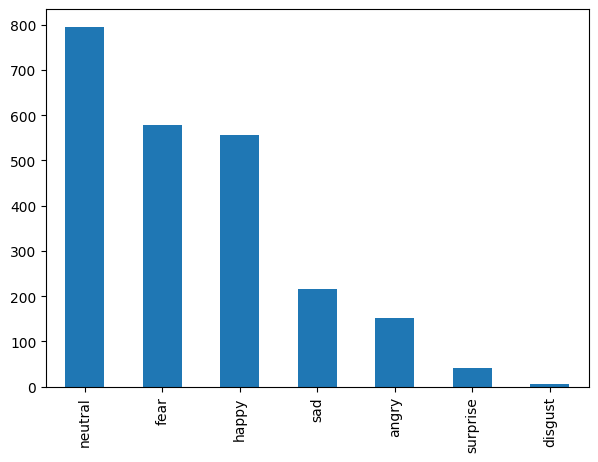

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
df_v1_no_null_corrected_fear.loc[df_v1_no_null_corrected_fear.hair_color.notnull()]['expression'].value_counts().plot(kind='bar')

In [ ]:
df_v1

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000001.jpg,36,1,happy,1,3,Brown_Hair
1,000002.jpg,32,1,happy,1,3,Brown_Hair
2,000003.jpg,33,0,neutral,0,4,NaN
3,000004.jpg,30,1,sad,1,5,NaN
4,000005.jpg,30,1,neutral,1,5,NaN
...,...,...,...,...,...,...,...
55043,055044.jpg,30,1,happy,1,3,Black_Hair
55044,055045.jpg,35,0,sad,0,5,NaN
55045,055046.jpg,27,1,neutral,1,4,Blond_Hair
55046,055047.jpg,46,0,surprise,0,6,NaN


In [ ]:
df_v1_no_null = df_v1.loc[df_v1.hair_color.notnull()]
merged=df_v1_no_null_corrected_fear.combine_first(df_v1_no_null)
merged

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000011.jpg,34,1,happy,1,2,Black_Hair
1,000024.jpg,30,1,fear,1,2,Blond_Hair
2,000036.jpg,35,0,fear,0,2,Black_Hair
3,000049.jpg,46,0,sad,0,2,Black_Hair
4,000067.jpg,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...
55036,055037.jpg,43,0,happy,0,3,Gray_Hair
55039,055040.jpg,30,1,happy,1,3,Brown_Hair
55041,055042.jpg,32,1,happy,1,3,Blond_Hair
55043,055044.jpg,30,1,happy,1,3,Black_Hair


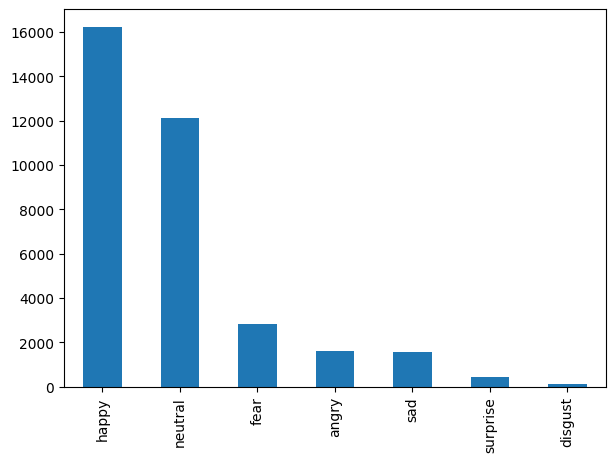

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
merged['expression'].value_counts().plot(kind='bar')

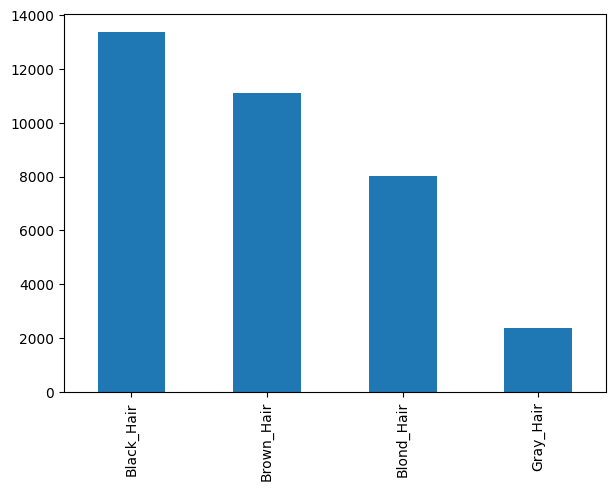

In [ ]:
merged['hair_color'].value_counts().plot(kind='bar')

In [ ]:
def correct_expression(row, emotion):
  from fer import FER
  test_image_one = plt.imread(dir_data+"/"+row['image_id'])
  #emo_detector = FER(mtcnn=True)
  emo_detector = FER()
  # Capture all the emotions on the image
  captured_emotions = emo_detector.detect_emotions(test_image_one)
  # Print all captured emotions with the image
  #print(captured_emotions)
  #plt.imshow(test_image_one)

  # Use the top Emotion() function to call for the dominant emotion in the image
  dominant_emotion, emotion_score = emo_detector.top_emotion(test_image_one)
  #print(dominant_emotion, emotion_score)

  if captured_emotions and dominant_emotion!=emotion:
    if abs(emotion_score - captured_emotions[0]['emotions'][emotion]) <=0.20:
      return row['expression']
    else:
      return dominant_emotion
  else:
    return row['expression']


In [ ]:
merged.loc[merged.expression=='angry']

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
72,001765.jpg,27,0,angry,0,2,Brown_Hair
92,002131.jpg,34,0,angry,0,2,Gray_Hair
99,002277.jpg,26,0,angry,0,2,Black_Hair
103,002448.jpg,29,1,angry,1,2,Black_Hair
140,003252.jpg,45,0,angry,0,2,Gray_Hair
...,...,...,...,...,...,...,...
54931,054932.jpg,44,0,angry,0,0,Gray_Hair
54954,054955.jpg,44,0,angry,0,0,Gray_Hair
54969,054970.jpg,36,1,angry,1,0,Blond_Hair
54975,054976.jpg,27,0,angry,0,5,Brown_Hair


In [ ]:
dir_data='/content/celeba/img_align_celeba'
df_v1_no_null_corrected_angry= merged.loc[merged.expression=='angry'].copy()
df_v1_no_null_corrected_angry['expression']= df_v1_no_null_corrected_angry.apply(lambda x: correct_expression(x, 'angry'), axis = 1)
df_v1_no_null_corrected_angry

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
72,001765.jpg,27,0,angry,0,2,Brown_Hair
92,002131.jpg,34,0,angry,0,2,Gray_Hair
99,002277.jpg,26,0,angry,0,2,Black_Hair
103,002448.jpg,29,1,angry,1,2,Black_Hair
140,003252.jpg,45,0,angry,0,2,Gray_Hair
...,...,...,...,...,...,...,...
54931,054932.jpg,44,0,angry,0,0,Gray_Hair
54954,054955.jpg,44,0,neutral,0,0,Gray_Hair
54969,054970.jpg,36,1,angry,1,0,Blond_Hair
54975,054976.jpg,27,0,angry,0,5,Brown_Hair


In [ ]:
df_columns = df_v1_no_null_corrected_angry.columns
np.savez('df_v1_no_null_corrected_angry.npz', df_v1_no_null_corrected_angry=df_v1_no_null_corrected_angry.values, df_columns=df_columns)

In [ ]:
merged.loc[merged.image_id=='054955.jpg']

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
54954,054955.jpg,44,0,angry,0,0,Gray_Hair


In [ ]:
df_v1_no_null_corrected_angry.loc[df_v1_no_null_corrected_angry.image_id=='054955.jpg']

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
54954,054955.jpg,44,0,neutral,0,0,Gray_Hair


In [ ]:
merged_last=df_v1_no_null_corrected_angry.combine_first(merged)
merged_last.loc[merged_last.image_id=='054955.jpg']

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
54954,054955.jpg,44,0,neutral,0,0,Gray_Hair


In [ ]:
merged_last

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000011.jpg,34,1,happy,1,2,Black_Hair
1,000024.jpg,30,1,fear,1,2,Blond_Hair
2,000036.jpg,35,0,fear,0,2,Black_Hair
3,000049.jpg,46,0,sad,0,2,Black_Hair
4,000067.jpg,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...
55036,055037.jpg,43,0,happy,0,3,Gray_Hair
55039,055040.jpg,30,1,happy,1,3,Brown_Hair
55041,055042.jpg,32,1,happy,1,3,Blond_Hair
55043,055044.jpg,30,1,happy,1,3,Black_Hair


In [ ]:
df_columns = merged_last.columns
np.savez('merged_last_version.npz', merged_last=merged_last.values, df_columns=df_columns)

In [ ]:
merged_last.columns

Index(['image_id', 'predicted_age', 'gender', 'expression', 'gender_id',
       'expression_id', 'hair_color'],
      dtype='object')

## Mask of hairs and calculation of color

In [ ]:
dir_output_local = r"/content/segmentation_masks/"
with ZipFile('/content/drive/MyDrive/segmentation_masks.zip', "r") as zipobj:
    zipobj.extractall(dir_output_local)

FileNotFoundError: ignored

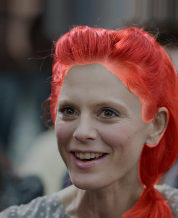

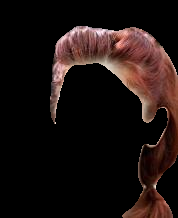

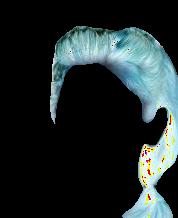

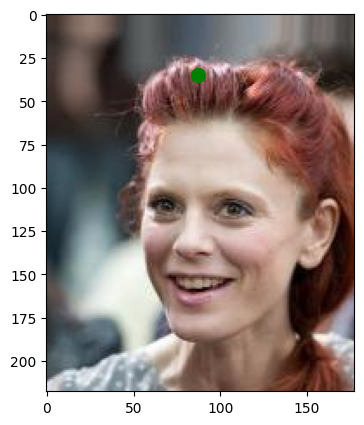

99


In [ ]:
import cv2
import sys
import numpy as np
import os
import sys
import glob
import shutil



g_label_face = 128
g_label_hair = 255

g_hair_color_display = (0, 0, 255)
g_skin_color_display = (0, 255, 0)


def find_corresponding_images(masks_dir, input_images_dir, input_ext='.png'):
    """
    :param masks_dir: path to the folder which contains the segmentation masks
    :param input_images_dir: path to the folder which contains the input images
    :param input_ext: the extension of the input images (by default png)
    :return a list of tuples (image-mask), where each element is a mapping between the path of the input image
            and the path of the corresponding segmentation mask
    """
    if not os.path.exists(masks_dir) or not os.path.isdir(masks_dir):
        raise ValueError('The path for the masks directory %s does not exist or is not a folder' % masks_dir)
    if not os.path.exists(input_images_dir) or not os.path.isdir(input_images_dir):
        raise ValueError('The path for the input images directory %s does not exist or is not a folder' % input_images_dir)

    # find the segmentation masks (bmp) images in the masks directory
    mask_files = glob.glob(os.path.join(masks_dir, "*.bmp"))
    print('Found %d segmentation masks ' % len(mask_files))

    num_images = len(mask_files)

    image_tuples = []
    for idx, mask_path in enumerate(mask_files):
        basename = os.path.basename(mask_path)
        sys.stdout.write('\r>> Searching image for  segmentation mask %s (%d/%d) ' % (basename, idx, num_images))
        sys.stdout.flush()
        img_path = os.path.join(input_images_dir, basename.replace('.bmp', input_ext))
        if os.path.exists(img_path):
            image_tuples.append((img_path, mask_path))
        else:
            sys.stdout.write('\r>> Error! Could not find input image for segmentation %s' % basename)
            sys.stdout.flush()

    return image_tuples


def overlay_mask_with_color(img, seg_mask, color):
    color_img = np.zeros(img.shape, img.dtype)
    color_img[:, :] = color

    color_mask = cv2.bitwise_and(color_img, color_img, mask=seg_mask)
    display_image = cv2.addWeighted(color_mask, 0.3, img, 0.7, 0)
    return display_image


def overlay_segmentation(img, mask):
    """ Overlays the hair-face segmentation over the input image
    :param img: input bgr-image containing the color image
    :param mask: input greyscale image containing the segmentation mask
                (0 - background pixel,
                1 - skin pixel,
                2 - hair pixel)
    :return: a "pretty" view of the segmentation (the segmentation mask: mask is super-imposed over the input image: img)
    """
    hair_mask = np.zeros(mask.shape, dtype=np.uint8)
    hair_mask[mask == g_label_hair] = 255
    segmentation_color = overlay_mask_with_color(img, hair_mask, g_hair_color_display)

    #skin_mask = np.zeros(mask.shape, dtype=np.uint8)
    #skin_mask[mask == g_label_face] = 255
    #segmentation_color = overlay_mask_with_color(segmentation_color, skin_mask, g_skin_color_display)

    return segmentation_color

def get_hair_pixels(img, mask):
    hair_mask = np.zeros(mask.shape, dtype=np.uint8)
    hair_mask[mask == g_label_hair] = 255
    color_img = np.zeros(img.shape, img.dtype)
    color_img[:, :] = img
    color_mask = cv2.bitwise_and(color_img, color_img, mask=hair_mask)
    return color_mask


def view_segmentations(masks_dir, input_images_dir):
    """ 'Pretty' display the segmentation images. Use the keys to navigate through the images:
        - press 'p' key for previous image
        - press 'r' key to restart
    :param masks_dir: path to the directory where the segemntation masks are stored
    :param input_images_dir: path to the directory where the input images corresponding to the segemntations are stored
    :return: None
    """
    image_pairs = find_corresponding_images(masks_dir, input_images_dir)
    print(image_pairs)
    #cv2.namedWindow('segmentation', cv2.WINDOW_NORMAL)

    idx = 0
    num_images = len(image_pairs)

    if num_images>0:
      img_path, mask_path = image_pairs[idx]
      mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
      img = cv2.imread(img_path)

      seg_display = overlay_segmentation(img, mask)
      cv2_imshow( seg_display)

      

m_dir, i_dir = '/content/segmentation_masks/segmentation_masks/','/content/celeba/img_align_celeba/'
#view_segmentations(m_dir, i_dir)

img_path, mask_path = i_dir+"000002.jpg", m_dir+'000002.bmp'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
img = cv2.imread(img_path)
seg_display = overlay_segmentation(img, mask)
from google.colab.patches import cv2_imshow
cv2_imshow(seg_display)

masked_image= get_hair_pixels(img, mask)
cv2_imshow(masked_image)
#print(cv2.cvtColor(masked_image, cv2.COLOR_BGR2HSV))

from PIL import Image
masked_image_pil = Image.fromarray(masked_image)
reduced = masked_image_pil.convert("P", palette=Image.WEB) # convert to web palette (216 colors)
palette = reduced.getpalette() # get palette as [r,g,b,r,g,b,...]
palette = [palette[3*n:3*n+3] for n in range(256)] # group 3 by 3 = [[r,g,b],[r,g,b],...]
color_count = [(n, palette[m]) for n,m in reduced.getcolors()]
#print(sorted(color_count, reverse=True))


# Convert grayscale image to RGB
hair_mask = np.zeros(mask.shape, dtype=np.uint8)
hair_mask[mask == g_label_hair] = 255
mask2 = np.stack((hair_mask,)*3, axis=-1)
# Multiply arrays
resultant = img*mask2
cv2_imshow(resultant)
hsv_frame=cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

height, width = hair_mask.shape
cx = int(width / 5)
cy = int(height / 2.5)
# Pick pixel value
pixel_center = hsv_frame[cy, cx]
hue_value = pixel_center[0]

plt.imshow(img[:,:,::-1])
plt.plot(cy, cx, "og", markersize=10)  # og:shorthand for green circle
plt.show()
print(hue_value)

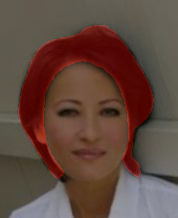

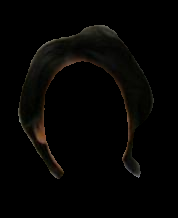

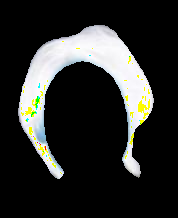

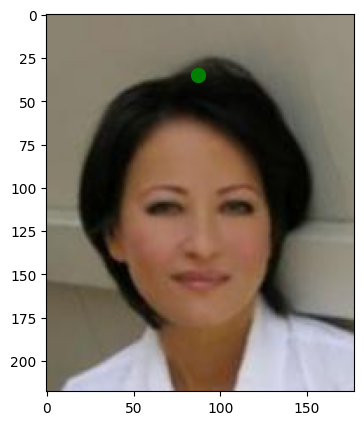

42


In [ ]:
m_dir, i_dir = '/content/segmentation_masks/segmentation_masks/','/content/celeba/img_align_celeba/'
#view_segmentations(m_dir, i_dir)

img_path, mask_path = i_dir+"000101.jpg", m_dir+'000101.bmp'
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
img = cv2.imread(img_path)
seg_display = overlay_segmentation(img, mask)
from google.colab.patches import cv2_imshow
cv2_imshow(seg_display)

masked_image= get_hair_pixels(img, mask)
cv2_imshow(masked_image)
#print(cv2.cvtColor(masked_image, cv2.COLOR_BGR2HSV))

from PIL import Image
masked_image_pil = Image.fromarray(masked_image)
reduced = masked_image_pil.convert("P", palette=Image.WEB) # convert to web palette (216 colors)
palette = reduced.getpalette() # get palette as [r,g,b,r,g,b,...]
palette = [palette[3*n:3*n+3] for n in range(256)] # group 3 by 3 = [[r,g,b],[r,g,b],...]
color_count = [(n, palette[m]) for n,m in reduced.getcolors()]
#print(sorted(color_count, reverse=True))


# Convert grayscale image to RGB
hair_mask = np.zeros(mask.shape, dtype=np.uint8)
hair_mask[mask == g_label_hair] = 255
mask2 = np.stack((hair_mask,)*3, axis=-1)
# Multiply arrays
resultant = img*mask2
cv2_imshow(resultant)
hsv_frame=cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

height, width = hair_mask.shape
cx = int(width / 5)
cy = int(height / 2.5)
# Pick pixel value
pixel_center = hsv_frame[cy, cx]
hue_value = pixel_center[0]

plt.imshow(img[:,:,::-1])
plt.plot(cy, cx, "og", markersize=10)  # og:shorthand for green circle
plt.show()
print(hue_value)

In [ ]:
hair_mask.shape

(218, 178)

In [ ]:
!pip install MTCNN

     |████████████████████████████████| 2.3 MB 6.6 MB/s 


In [ ]:
import pandas as pd
import numpy as np
import cv2
from mtcnn.mtcnn import MTCNN 

detector = MTCNN()
cap = cv2.VideoCapture(0)

csv_path_face = '/content/color5.xlsx'
csv_path_hair = '/content/color6.xlsx'
index = ['color', 'color_name', 'hex', 'R', 'G', 'B','R1', 'G1', 'B1']
df_f = pd.read_excel(csv_path_face, names=index, header=None)
df_h = pd.read_excel(csv_path_hair, names=index, header=None)

# define HSV color ranges for eyes colors
class_name = ("Blue", "Blue Gray", "Brown", "Brown Gray", "Brown Black", "Green", "Green Gray", "Other")
EyeColor = {
    class_name[0] : ((166, 21, 50), (240, 100, 85)),
    class_name[1] : ((166, 2, 25), (300, 20, 75)),
    class_name[2] : ((2, 20, 20), (40, 100, 60)),
    class_name[3] : ((20, 3, 30), (65, 60, 60)),
    class_name[4] : ((0, 10, 5), (40, 40, 25)),
    class_name[5] : ((60, 21, 50), (165, 100, 85)),
    class_name[6] : ((60, 2, 25), (165, 20, 65))
}
#_______________________________________________________________________________________________________________________
def check_color(hsv, color):
    if (hsv[0] >= color[0][0]) and (hsv[0] <= color[1][0]) and (hsv[1] >= color[0][1]) and \
    hsv[1] <= color[1][1] and (hsv[2] >= color[0][2]) and (hsv[2] <= color[1][2]):
        return True
    else:
        return False
#_______________________________________________________________________________________________________________________
# define eye color category rules in HSV space
def find_class(hsv):
    color_id = 7
    for i in range(len(class_name)-1):
        if check_color(hsv, EyeColor[class_name[i]]) == True:
            color_id = i

    return color_id
#_____________________________________________________________________________________________________________________
#define RGB for face
def get_color_name_face(R,G,B):
    minimum = 1000
    for i in range(len(df_f)):
        Rd = ((df_f.loc[i,'R'])+(df_f.loc[i,'R1']))/2
        Gd = ((df_f.loc[i,'G'])+(df_f.loc[i,'G1']))/2
        Bd = ((df_f.loc[i,'B'])+(df_f.loc[i,'B1']))/2
        d = abs(R - int(Rd)) + abs(G - int(Gd)) + abs(B - int(Bd))
        if d <= minimum:
            minimum = d
            cname = df_f.loc[i, 'color_name']

    return cname
#______________________________________________________________________________________________________________________
#define RGB for hair
def get_color_name_hair(R,G,B):
    minimum = 1000
    for i in range(len(df_h)):
        Rd = ((df_h.loc[i,'R'])+(df_h.loc[i,'R1']))/2
        Gd = ((df_h.loc[i,'G'])+(df_h.loc[i,'G1']))/2
        Bd = ((df_h.loc[i,'B'])+(df_h.loc[i,'B1']))/2
        d = abs(R - int(Rd)) + abs(G - int(Gd)) + abs(B - int(Bd))
        if d <= minimum:
            minimum = d
            cname = df_h.loc[i, 'color_name']

    return cname
#_____________________________________________________________________________________________________________________
def eye_color(image):
    imgHSV = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    h, w = image.shape[0:2]
    imgMask = np.zeros((image.shape[0], image.shape[1], 1))
    result = detector.detect_faces(image)
    if result == []:
        print('Warning: Can not detect any face in the input image!')
        return

    left_eye = result[0]['keypoints']['left_eye']
    right_eye = result[0]['keypoints']['right_eye']

    eye_distance = np.linalg.norm(np.array(left_eye)-np.array(right_eye))
    eye_radius = eye_distance/15 # approximate

    cv2.circle(image, left_eye, int(eye_radius), (0, 155, 255), 1)
    cv2.circle(image, right_eye, int(eye_radius), (0, 155, 255), 1)

    eye_class = np.zeros(len(class_name), np.float)

    #Key range
    for y in range(0, h):
        for x in range(0, w):
            if imgMask[y, x] != 0:
                eye_class[find_class(imgHSV[y,x])] +=1 

    main_color_index = np.argmax(eye_class[:len(eye_class)-1])
    total_vote = eye_class.sum()
    
    print("\n\nDominant Eye Color: ", class_name[main_color_index])
    # print("\n **Eyes Color Percentage **")

    # for i in range(len(class_name)):
        # print(class_name[i], ": ", round(eye_class[i]/total_vote*100, 2), "%")
    
    label = 'Eye Color: %s' % class_name[main_color_index]

    cv2.putText(image, label, (left_eye[0]-10, left_eye[1]-40), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (155,255,0))

    cv2.imshow('COLOR-DETECTION', image)
#____________________________________________________________________________________________________________________________________
# Define Hair Color    
def hair_color(image):
    result = detector.detect_faces(image)
    bounding_box = result[0]['box'] 
    centerCoord_hair = (bounding_box[0]+(bounding_box[2]/2), (bounding_box[1]-(bounding_box[3]/2)-35)+(bounding_box[3]/2))
    cv2.circle(image,(int(centerCoord_hair[0]),int(centerCoord_hair[1])),5,(0,155,255), 2)
    y = int(centerCoord_hair[0])
    x = int(centerCoord_hair[1])
    (b, g, r) = image[y,x]
    print("Hair color: ", get_color_name_hair(b,g,r)) 

    label =  'Hair Color: %s' % get_color_name_hair(b,g,r)
    cv2.putText(image,label,(bounding_box[0],bounding_box[1]-int(bounding_box[3]/3)),cv2.FONT_HERSHEY_SIMPLEX, 0.5, (155,255,0))
    cv2_imshow(image)
#_________________________________________________________________________________________________________________________________________
# Define Face Color    
def face_color(image):
    result = detector.detect_faces(image)
    bounding_box = result[0]['box'] 
    forehead = ((bounding_box[0]+(bounding_box[2]/2)),(bounding_box[1]+(bounding_box[3]/6)))
    cv2.circle(image,(int(forehead[0]),int(forehead[1])),5,(0,155,255), 2)
    y = int(forehead[0])
    x = int(forehead[1])
    (b, g, r) = image[y,x]
    print("Face COlor: ",get_color_name_face(b,g,r))
    label =  'Face Color: %s' % get_color_name_face(b,g,r)
    p = (bounding_box[0]+(bounding_box[2]/6))
    q = (bounding_box[1]+(bounding_box[3]/2))
    cv2.putText(image,label,(int(p),int(q)),cv2.FONT_HERSHEY_SIMPLEX, 0.5, (155,255,0))
    
    cv2.imshow('COLOR-DETECTION', image)
#_____________________________________________________________________________________________________________________________________________


Hair color:  Lightest Blonde


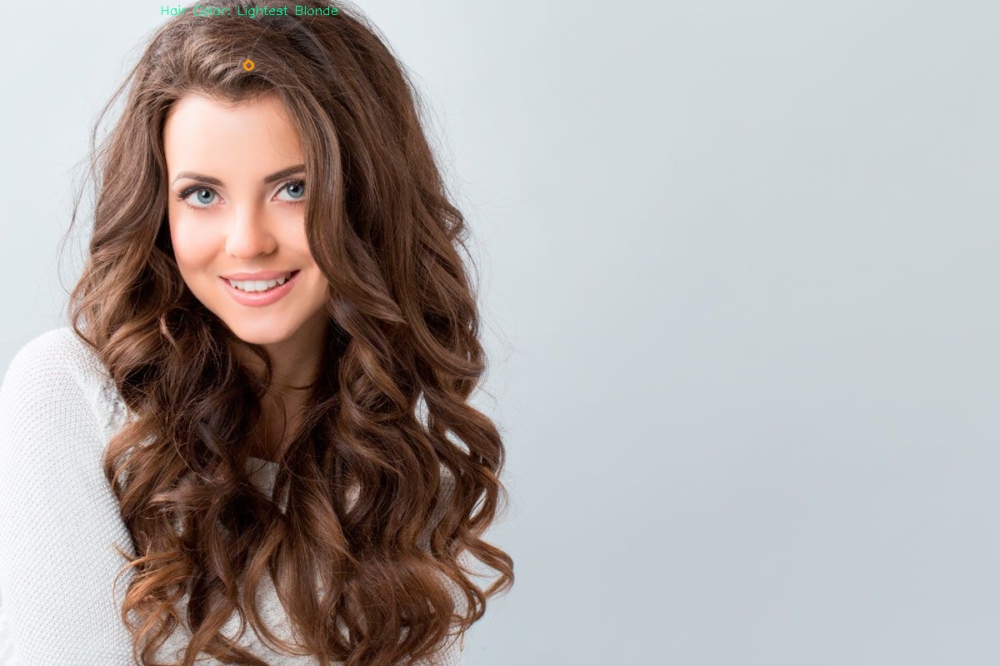

In [ ]:
url= '/content/brown.jpg'
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread(url)
hair_color(img)

# Data augmentation

In [ ]:
np_file = np.load('/content/drive/MyDrive/TFG/merged_last_version.npz', allow_pickle=True)
merged_last=pd.DataFrame(np_file['merged_last'], columns=np_file['df_columns'])
merged_last

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000011.jpg,34,1,happy,1,2,Black_Hair
1,000024.jpg,30,1,fear,1,2,Blond_Hair
2,000036.jpg,35,0,fear,0,2,Black_Hair
3,000049.jpg,46,0,sad,0,2,Black_Hair
4,000067.jpg,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...
34870,055037.jpg,43,0,happy,0,3,Gray_Hair
34871,055040.jpg,30,1,happy,1,3,Brown_Hair
34872,055042.jpg,32,1,happy,1,3,Blond_Hair
34873,055044.jpg,30,1,happy,1,3,Black_Hair


In [ ]:
from PIL import Image
import numpy as np
dir_data='/content/celeba/img_align_celeba'

def obtain_x_y(final_df):
  X, Y = [],[]
  # and you can iterate over this in for loop
  for image_name, categories in zip(final_df['image_id'],final_df[['predicted_age', 'gender', 'expression', 'gender_id',
       'expression_id', 'hair_color']].values):
      image = np.asarray(Image.open(dir_data+"/"+image_name))
      X.append(image)
      Y.append(categories)
  return X, Y

In [ ]:
X, Y = obtain_x_y(merged_last)

In [ ]:
len(X), len(Y)

(34875, 34875)

In [ ]:
np.savez('numpy_dataset.npz', X=X, Y=Y)

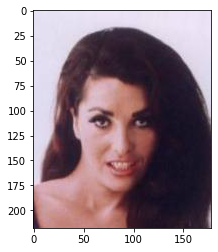

In [ ]:
plt.imshow(X[0])

In [ ]:
import cv2
import random
import numpy as np

def changes_in_brightness(img, low, high):
    value = random.uniform(low, high)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv = np.array(hsv, dtype = np.float64)
    hsv[:,:,1] = hsv[:,:,1]*value
    hsv[:,:,1][hsv[:,:,1]>255]  = 255
    hsv[:,:,2] = hsv[:,:,2]*value 
    hsv[:,:,2][hsv[:,:,2]>255]  = 255
    hsv = np.array(hsv, dtype = np.uint8)
    img = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return img


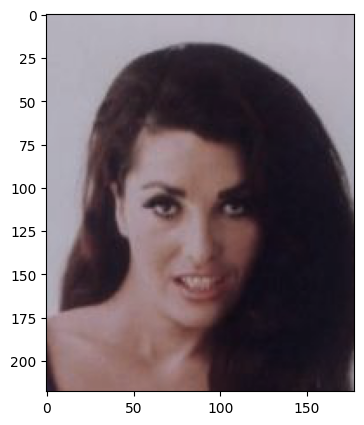

In [ ]:
img_result = changes_in_brightness(X[0], 0.1, 2)
plt.imshow(img_result)

## Augmenting surprise

happy       16402
neutral     12530
fear         2838
sad          1661
angry         861
surprise      450
disgust       133
Name: expression, dtype: int64


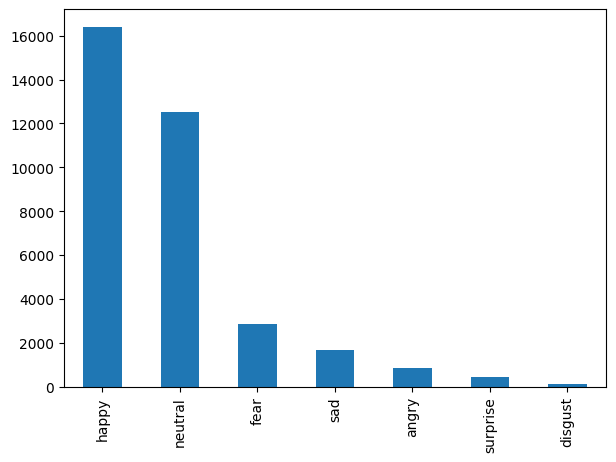

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
merged_last['expression'].value_counts().plot(kind='bar')
print(merged_last['expression'].value_counts())

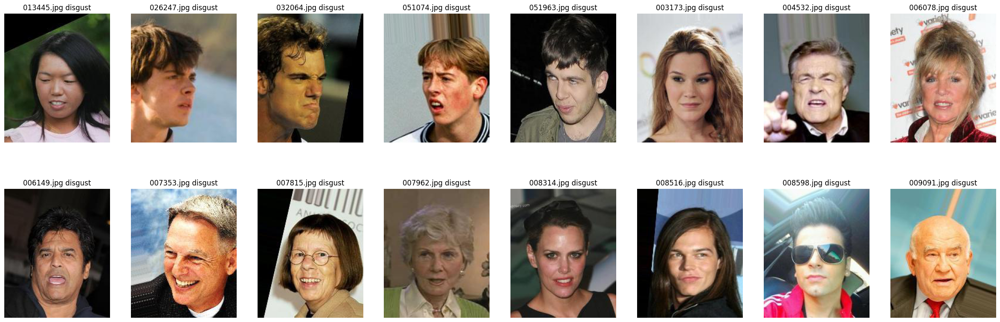

In [ ]:
dir_data='/content/celeba/img_align_celeba'

num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)
for index, row in merged_last.loc[merged_last.expression=='disgust'][:16].reset_index().iterrows():
    rows = 2
    cols=8
    image = load_img(dir_data + "/" + row.image_id)
    image = img_to_array(image)/255.0
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.title(row.image_id+' '+row.expression)
    plt.imshow(image)

In [ ]:
dir_data='/content/celeba/img_align_celeba'
merged_last_corrected= merged_last.loc[merged_last.expression=='disgust'].copy()
merged_last_corrected['expression']= merged_last_corrected.apply(lambda x: correct_expression(x, 'disgust'), axis = 1)
merged_last_corrected

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
571,013445.jpg,32,1,disgust,1,2,Black_Hair
1131,026247.jpg,24,0,disgust,0,2,Brown_Hair
1365,032064.jpg,26,0,disgust,0,2,Brown_Hair
2164,051074.jpg,30,0,disgust,0,2,Brown_Hair
2202,051963.jpg,25,0,disgust,0,2,Black_Hair
...,...,...,...,...,...,...,...
34370,054241.jpg,32,0,neutral,0,1,Black_Hair
34616,054645.jpg,24,1,sad,1,1,Brown_Hair
34731,054825.jpg,50,0,neutral,0,1,Gray_Hair
34785,054908.jpg,27,0,disgust,0,1,Gray_Hair


In [ ]:
final_df=merged_last_corrected.combine_first(merged_last)
final_df

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000011.jpg,34,1,happy,1,2,Black_Hair
1,000024.jpg,30,1,fear,1,2,Blond_Hair
2,000036.jpg,35,0,fear,0,2,Black_Hair
3,000049.jpg,46,0,sad,0,2,Black_Hair
4,000067.jpg,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...
34870,055037.jpg,43,0,happy,0,3,Gray_Hair
34871,055040.jpg,30,1,happy,1,3,Brown_Hair
34872,055042.jpg,32,1,happy,1,3,Blond_Hair
34873,055044.jpg,30,1,happy,1,3,Black_Hair


In [ ]:
np.savez('/content/drive/MyDrive/TFG/final_pandas_df.npz', final_df=final_df, columns=final_df.columns)

happy       16444
neutral     12566
fear         2839
sad          1677
angry         888
surprise      450
disgust        11
Name: expression, dtype: int64


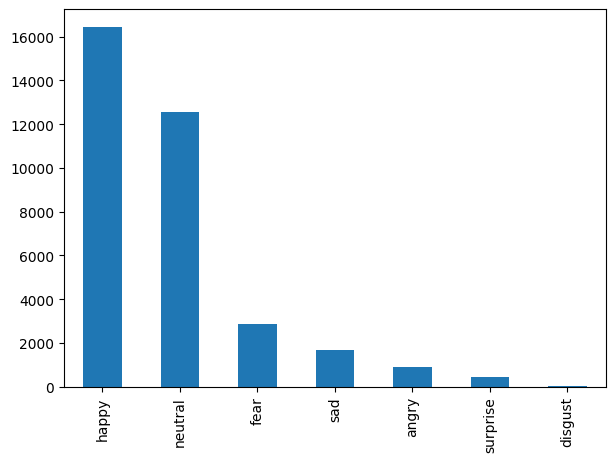

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
final_df['expression'].value_counts().plot(kind='bar')
print(final_df['expression'].value_counts())

In [ ]:
files_df = np.load('/content/drive/MyDrive/TFG/final_pandas_df.npz', allow_pickle=True)
final_df = pd.DataFrame(files_df['final_df'], columns=files_df['columns'])

X, Y = obtain_x_y(final_df)
np.savez('/content/drive/MyDrive/TFG/numpy_dataset_final_version.npz', X=X, Y=Y)

In [ ]:
files = np.load('/content/drive/MyDrive/TFG/numpy_dataset_final_version.npz')

In [ ]:
X= files['X']
Y= files['Y']

In [ ]:
len(X), len(Y)

(34875, 34875)

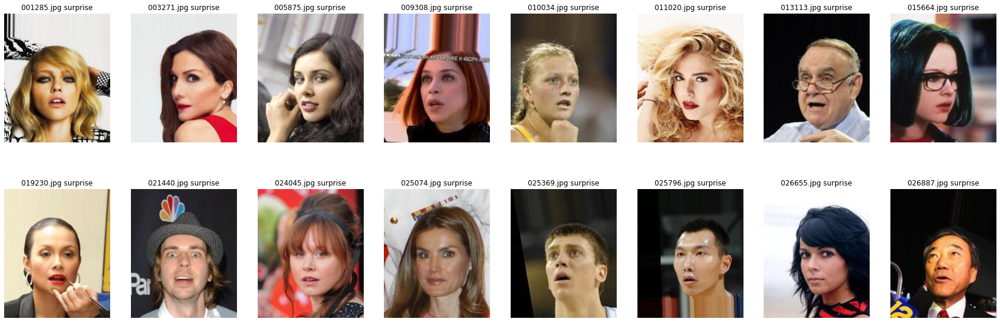

In [ ]:
dir_data='/content/celeba/img_align_celeba'


num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)
for index, row in final_df.loc[final_df.expression=='surprise'][:16].reset_index().iterrows():
    rows = 2
    cols=8
    image = load_img(dir_data + "/" + row.image_id)
    image = img_to_array(image)/255.0
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.title(row.image_id+' '+row.expression)
    plt.imshow(image) 

In [ ]:
final_df[['predicted_age', 'gender', 'expression', 'gender_id','expression_id', 'hair_color']].values

array([[34, 1, 'happy', 1, 2, 'Black_Hair'],
       [30, 1, 'fear', 1, 2, 'Blond_Hair'],
       [35, 0, 'fear', 0, 2, 'Black_Hair'],
       ...,
       [32, 1, 'happy', 1, 3, 'Blond_Hair'],
       [30, 1, 'happy', 1, 3, 'Black_Hair'],
       [27, 1, 'neutral', 1, 4, 'Blond_Hair']], dtype=object)

In [ ]:
suprise_df= final_df.loc[final_df.expression == 'surprise']
X_surprise,Y_surprise = obtain_x_y(suprise_df)

In [ ]:
Y[0]

'happy'

In [ ]:
import cv2
import random

def augment_data(imgs, scales, rotations, brightness_values, shifts, labels):
  timg=[]
  y_hat=[]
  for (img,label) in zip(imgs,labels):
    #img = load_img(dir_data + "/" + img_dir)
    #img = img_to_array(img)/255.0
    rows, cols, ch = img.shape 
    for j in rotations:
      f = random.randint(0, 1)
      rot_mat = cv2.getRotationMatrix2D( (14,14), j, 1);
      affined_img = cv2.warpAffine( img, rot_mat, (cols, rows), borderValue=(1,1,1))
      resulting_img = affined_img
      if f==1:
        resulting_img = cv2.flip(resulting_img, f)
      resulting_img = changes_in_brightness(resulting_img, brightness_values[0], brightness_values[1])
      timg.append(resulting_img)
      y_hat.append(label)
    #y_hat = [label] * len(timg)
  return np.array(timg), np.array(y_hat)

In [ ]:
scales = np.arange(0.9, 1, 0.1)
rotations = np.arange(1, 3)
brightness_values = [ 0.5, 1.7]
shifts = [ 0.2]
au_x, au_y = augment_data(X_surprise, scales, rotations, brightness_values, shifts, Y_surprise)


In [ ]:
len(au_x)

900

In [ ]:
np.savez('/content/drive/MyDrive/TFG/augmented_surprise.npz', au_x_surprise=au_x, au_y_surprise=au_y)

In [ ]:
len(au_y), au_y[0]

(900, array([28, 1, 'surprise', 1, 2, 'Blond_Hair'], dtype=object))

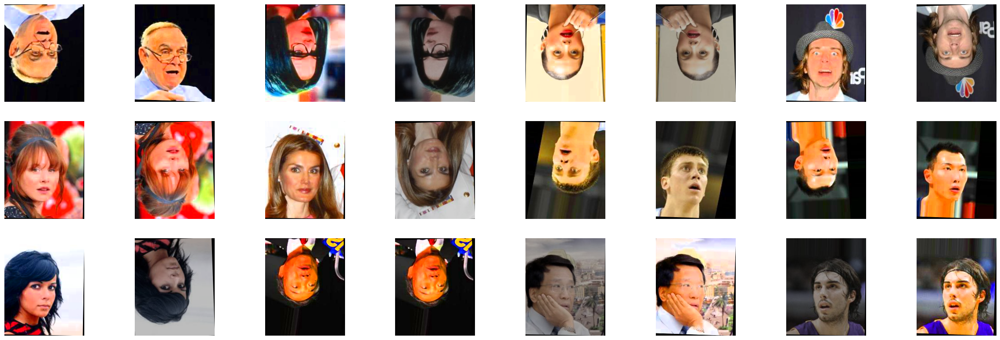

In [ ]:
num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)

for index,image in enumerate(au_x[12:36]):
    rows = 3
    cols=8
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.imshow(image) 

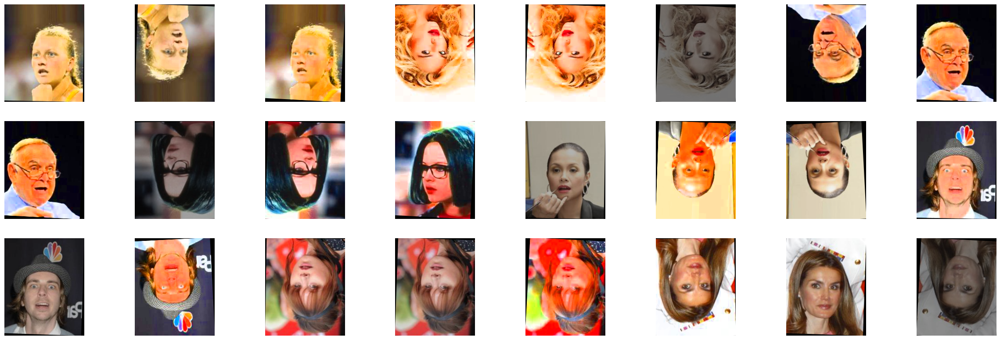

In [ ]:
num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)

for index,image in enumerate(au_x[12:36]):
    rows = 3
    cols=8
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.imshow(image) 

## Augmenting angry

In [ ]:
angry_df= final_df.loc[final_df.expression == 'angry']
X_angry,Y_angry = obtain_x_y(angry_df)

In [ ]:
rotations = np.arange(1, 2)
au_x_angry, au_y_angry = augment_data(X_angry, scales, rotations, brightness_values, shifts, Y_angry)

In [ ]:
au_y_angry[0]

array([27, 0, 'angry', 0, 2, 'Brown_Hair'], dtype=object)

In [ ]:
np.savez('/content/drive/MyDrive/TFG/augmented_angry.npz', au_x_angry=au_x_angry, au_y_angry=au_y_angry)

861


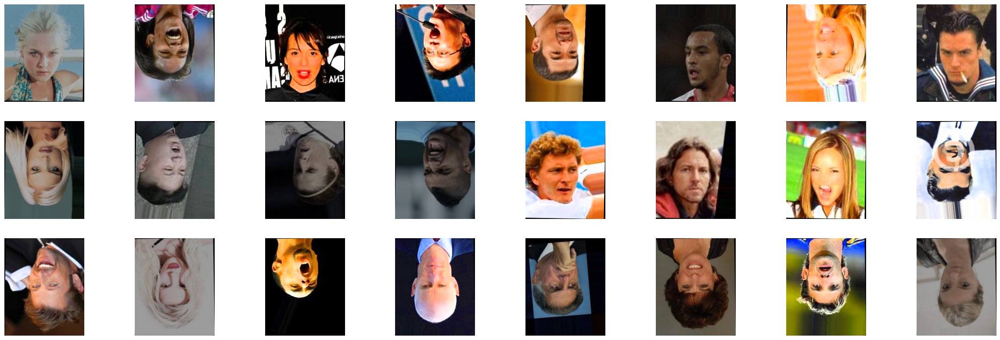

In [ ]:
print(len(au_x_angry))
num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)

for index,image in enumerate(au_x_angry[12:36]):
    rows = 3
    cols=8
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.imshow(image) 

## Dataset balanceado

In [ ]:
surprise = np.load('/content/drive/MyDrive/TFG/augmented_surprise.npz',allow_pickle=True)
angry = np.load('/content/drive/MyDrive/TFG/augmented_angry.npz',allow_pickle=True)

au_x_surprise, au_y_surprise = surprise['au_x_surprise'], surprise['au_y_surprise']
au_x_angry, au_y_angry = angry['au_x_angry'], angry['au_y_angry']
len(au_x_surprise),len(au_x_angry)

(900, 888)

In [ ]:
angry = np.load('/content/drive/MyDrive/TFG/augmented_angry.npz',allow_pickle=True)
au_x_angry, au_y_angry = angry['au_x_angry'], angry['au_y_angry']

In [ ]:
surprise = np.load('/content/drive/MyDrive/TFG/augmented_surprise.npz',allow_pickle=True)
au_x_surprise, au_y_surprise = surprise['au_x_surprise'], surprise['au_y_surprise']

In [ ]:
from PIL import Image
import numpy as np
dir_data='/content/celeba/img_align_celeba'

files = np.load('/content/drive/MyDrive/TFG/numpy_dataset_final_version.npz',allow_pickle=True)
#X= files['X']
Y= files['Y']

In [ ]:
len(X), type(X)

(34875, numpy.ndarray)

In [ ]:
type(Y)

numpy.ndarray

In [ ]:
from pandas.core.arrays.sparse import dtype
type(au_x), au_x.dtype

(numpy.ndarray, dtype('uint8'))

In [ ]:
X_total_np=np.concatenate((X, au_x_surprise), axis=0)
#X_total_np=np.concatenate((X_total_np, au_x_angry), axis=0)

#Y_total_np=np.concatenate((Y_total_np, au_y), axis=0)
#Y_total_np=np.concatenate((Y_total_np, au_y_angry), axis=0)

In [ ]:
np.savez('/content/drive/MyDrive/TFG/X_total_np_1.npz', X_total_np)

In [ ]:
X_total_np = np.load('/content/drive/MyDrive/TFG/X_total_np_1.npz',allow_pickle=True)['arr_0']

In [ ]:
len(X_total_np)

35775

In [ ]:
X_total_np=np.concatenate((X_total_np, au_x_angry), axis=0)

In [ ]:
np.savez('/content/drive/MyDrive/TFG/X_total_np_2_total.npz', X_total_np)

In [ ]:
len(X_total_np)

36663

In [ ]:
au_y_surprise.shape

(900, 6)

In [ ]:
Y.shape

(34875, 6)

In [ ]:
surprise = np.load('/content/drive/MyDrive/TFG/augmented_surprise.npz',allow_pickle=True)
au_y_surprise = surprise['au_y_surprise']

In [ ]:
angry = np.load('/content/drive/MyDrive/TFG/augmented_angry.npz',allow_pickle=True)
au_y_angry = angry['au_y_angry']

In [ ]:
Y_total_np=np.concatenate((Y, au_y_surprise), axis=0)
Y_total_np=np.concatenate((Y_total_np, au_y_angry), axis=0)

In [ ]:
np.savez('/content/drive/MyDrive/TFG/Y_total.npz', Y_total_np)

## Load balanced dataset

In [ ]:
X_total_np = np.load('/content/drive/MyDrive/TFG/X_total_np_2_total.npz', allow_pickle=True)['arr_0']
Y_total_np = np.load('/content/drive/MyDrive/TFG/Y_total.npz', allow_pickle=True)['arr_0']

In [ ]:
df= pd.DataFrame(Y_total_np, columns='predicted_age	gender	expression	gender_id	expression_id	hair_color'.split())
df

,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,34,1,happy,1,2,Black_Hair
1,30,1,fear,1,2,Blond_Hair
2,35,0,fear,0,2,Black_Hair
3,46,0,sad,0,2,Black_Hair
4,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...
36658,24,0,angry,0,0,Black_Hair
36659,44,0,angry,0,0,Gray_Hair
36660,36,1,angry,1,0,Blond_Hair
36661,27,0,angry,0,5,Brown_Hair


happy       16444
neutral     12566
fear         2839
angry        1776
sad          1677
surprise     1350
disgust        11
Name: expression, dtype: int64


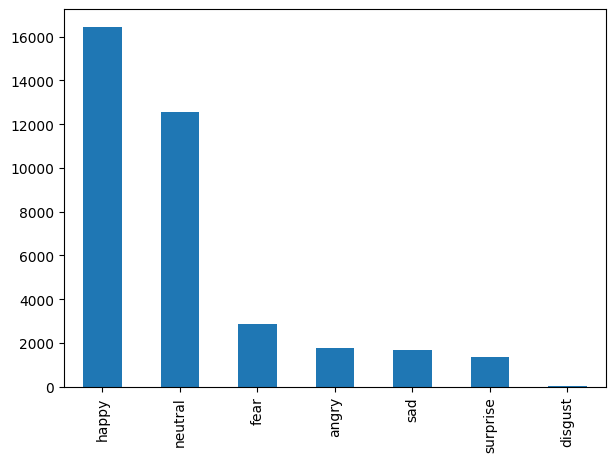

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
df['expression'].value_counts().plot(kind='bar')
print(df['expression'].value_counts())

Black_Hair    14090
Brown_Hair    11621
Blond_Hair     8342
Gray_Hair      2610
Name: hair_color, dtype: int64


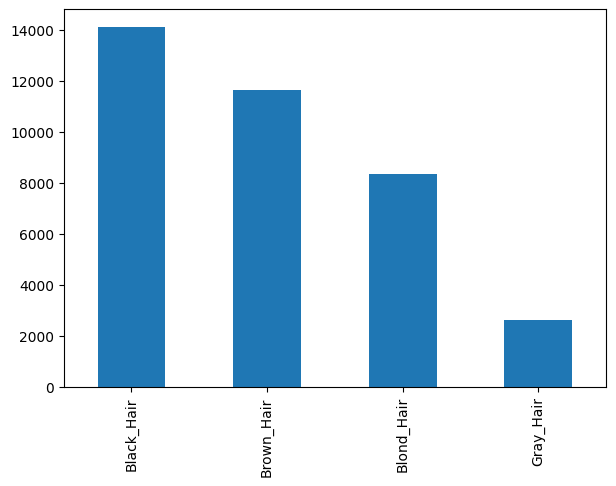

In [ ]:
plt.rcParams.update({'figure.figsize':(7,5), 'figure.dpi':100})
df['hair_color'].value_counts().plot(kind='bar')
print(df['hair_color'].value_counts())

In [ ]:
df.loc[df.hair_color=='Gray_Hair'].reset_index()

,index,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,6,49,1,happy,1,2,Gray_Hair
1,16,34,0,happy,0,2,Gray_Hair
2,28,47,0,fear,0,2,Gray_Hair
3,35,43,0,happy,0,2,Gray_Hair
4,38,51,1,happy,1,2,Gray_Hair
...,...,...,...,...,...,...,...
2605,36598,48,0,angry,0,0,Gray_Hair
2606,36618,38,0,angry,0,1,Gray_Hair
2607,36632,49,0,angry,0,0,Gray_Hair
2608,36655,52,0,angry,0,5,Gray_Hair


neutral     2069
happy       2051
fear        1981
angry       1776
sad         1677
surprise    1350
Name: expression, dtype: int64


,index,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,0,34,1,happy,1,2,Black_Hair
1,1,30,1,fear,1,2,Blond_Hair
2,2,35,0,fear,0,2,Black_Hair
3,3,46,0,sad,0,2,Black_Hair
4,4,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...
10899,36658,24,0,angry,0,0,Black_Hair
10900,36659,44,0,angry,0,0,Gray_Hair
10901,36660,36,1,angry,1,0,Blond_Hair
10902,36661,27,0,angry,0,5,Brown_Hair


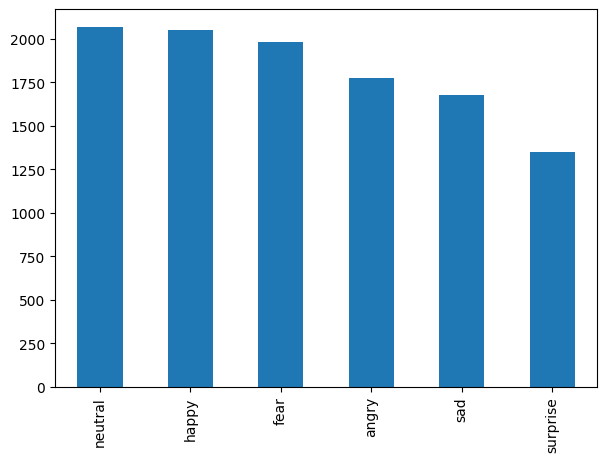

In [ ]:
df_rest = df.loc[(df.expression=='surprise') | (df.expression=='angry')|  (df.expression=='sad') | (df.hair_color=='Gray_Hair')]
df_rest = df_rest.combine_first(df.loc[df.expression=='happy'][:1200].copy())
df_rest = df_rest.combine_first(df.loc[df.expression=='neutral'][:1400].copy())
df_rest = df_rest.combine_first(df.loc[df.expression=='fear'][:1900].copy())
df_rest = df_rest.drop(df_rest[df_rest.expression=='disgust'].index)
df_rest['expression'].value_counts().plot(kind='bar')
print(df_rest['expression'].value_counts())
df_rest=df_rest.reset_index()
df_rest

In [ ]:
df_rest.values[4030][0]

4788

In [ ]:
len(df_rest)

10907

In [ ]:
X_filtered, Y_filtered=[],[]
for index, (image,values) in enumerate(zip(X,df_rest.iterrows())):
  if index == values[0]:
    X_filtered.append(image)
    Y_filtered.append(values)

In [ ]:
len(X_filtered), len(Y_filtered)

(10904, 10904)

neutral     2069
happy       2051
fear        1981
angry       1776
sad         1677
surprise    1350
Name: expression, dtype: int64


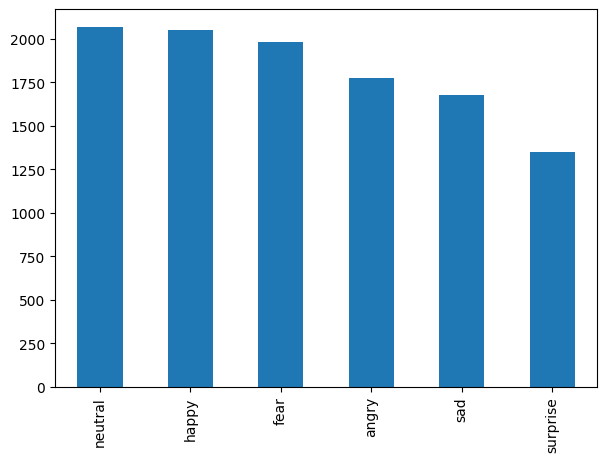

In [ ]:
df_rest['expression'].value_counts().plot(kind='bar')
print(df_rest['expression'].value_counts())

# A bit more augmentation

In [ ]:
#df_rest.loc[]

In [ ]:
rotations = np.arange(1, 2)
au_x_angry, au_y_angry = augment_data(X_angry, scales, rotations, brightness_values, shifts, Y_angry)

[34 1 'happy' 1 2 'Black_Hair']


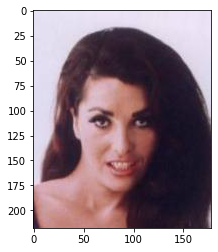

[30 1 'fear' 1 2 'Blond_Hair']


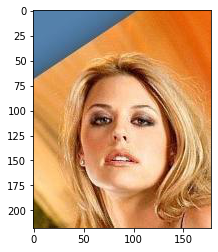

[35 0 'fear' 0 2 'Black_Hair']


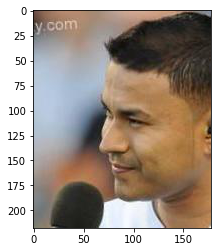

[46 0 'sad' 0 2 'Black_Hair']


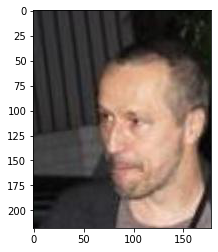

[29 0 'sad' 0 2 'Brown_Hair']


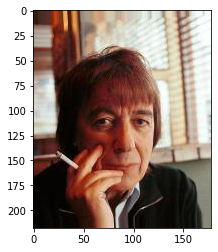

[34 0 'happy' 0 2 'Black_Hair']


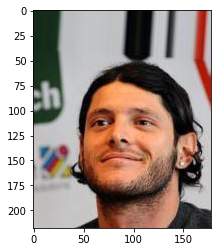

[49 1 'happy' 1 2 'Gray_Hair']


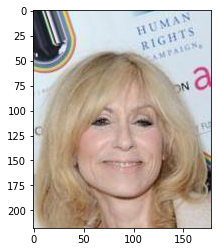

[31 1 'neutral' 1 2 'Brown_Hair']


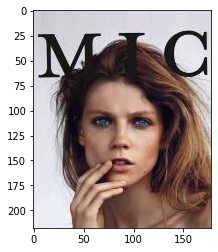

[42 0 'sad' 0 2 'Black_Hair']


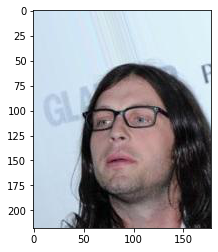

[23 0 'neutral' 0 2 'Black_Hair']


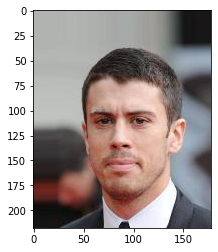

In [ ]:
for image,attr in list(zip(X_total_np,Y_total_np))[:10]:
  print(attr)
  plt.imshow(image) 
  plt.show()

In [ ]:
np.savez('/content/drive/MyDrive/TFG/df_rest.npz', df_rest)
np.savez('/content/drive/MyDrive/TFG/X_filtered.npz', X_filtered)
np.savez('/content/drive/MyDrive/TFG/Y_filtered.npz', Y_filtered)

/usr/local/lib/python3.7/dist-packages/numpy/lib/npyio.py:719: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


In [ ]:
files_df = np.load('/content/drive/MyDrive/TFG/df_rest.npz', allow_pickle=True)
files_X = np.load('/content/drive/MyDrive/TFG/X_filtered.npz', allow_pickle=True)
#files_Y = np.load('/content/drive/MyDrive/TFG/Y_filtered.npz', allow_pickle=True)
df_rest_files=files_df['arr_0']
X_filtered=files_X['arr_0']

In [ ]:
columns = 'index predicted_age gender	expression gender_id expression_id	hair_color hair_id'.split()
df_rest= pd.DataFrame(df_rest_files, columns=columns)
df_rest

,index,predicted_age,gender,expression,gender_id,expression_id,hair_color,hair_id
0,0,34,1,happy,1,2,Black_Hair,0
1,1,30,1,fear,1,1,Blond_Hair,2
2,2,35,0,fear,0,1,Black_Hair,0
3,3,46,0,sad,0,4,Black_Hair,0
4,4,29,0,sad,0,4,Brown_Hair,1
...,...,...,...,...,...,...,...,...
10899,36658,24,0,angry,0,0,Black_Hair,0
10900,36659,44,0,angry,0,0,Gray_Hair,3
10901,36660,36,1,angry,1,0,Blond_Hair,2
10902,36661,27,0,angry,0,0,Brown_Hair,1


In [ ]:
df_rest_files.shape

(10904, 8)

In [ ]:
X_filtered.shape

(10904, 218, 178, 3)

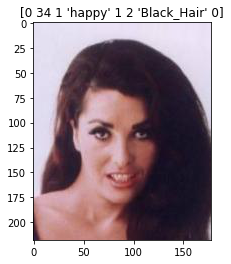

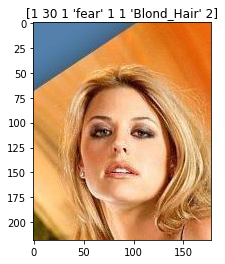

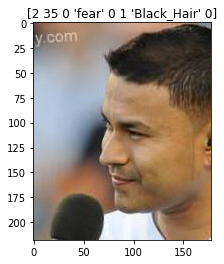

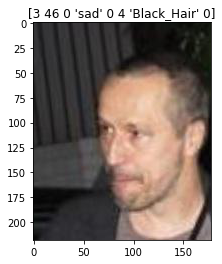

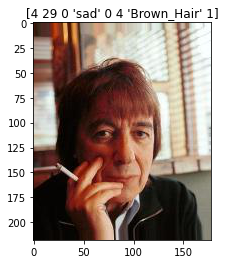

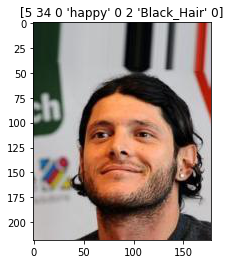

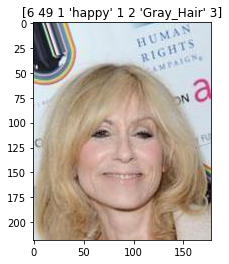

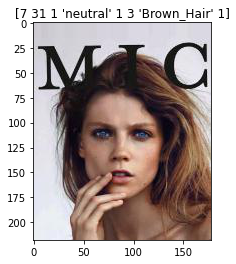

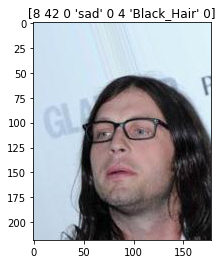

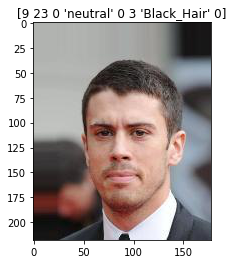

In [ ]:
for i in list(zip(X_filtered, df_rest_files))[:10]:
    plt.title(str(i[1]))
    plt.imshow(i[0])
    plt.show()

# Entrenar modelo

In [ ]:
df_train = df_rest.drop(columns=['index'])
df_train

,predicted_age,gender,expression,gender_id,expression_id,hair_color,hair_id
0,34,1,happy,1,2,Black_Hair,0
1,30,1,fear,1,1,Blond_Hair,2
2,35,0,fear,0,1,Black_Hair,0
3,46,0,sad,0,4,Black_Hair,0
4,29,0,sad,0,4,Brown_Hair,1
...,...,...,...,...,...,...,...
10899,24,0,angry,0,0,Black_Hair,0
10900,44,0,angry,0,0,Gray_Hair,3
10901,36,1,angry,1,0,Blond_Hair,2
10902,27,0,angry,0,0,Brown_Hair,1


In [ ]:
#np.savez(df_train)

In [ ]:
image_dir = r'/content/celeba/img_align_celeba/'

In [ ]:
import numpy as np 
import pandas as pd
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
#dataset_folder_name = dir_data
TRAIN_TEST_SPLIT = 0.7
dataset_dict = {
    # 'angry', 'fear', 'happy', 'neutral', 'sad', 'surprise'
    'expression_id': {
        0: 'angry',  
        1: 'fear', 
        2: 'happy', 
        3: 'neutral',
        4: 'sad',
        5: 'surprise'
    },
    'gender_id': {
        0: 0,
        1: 1
    },
    'hair_id': {
        0: 'Black_Hair',
        1: 'Brown_Hair',
        2: 'Blond_Hair',
        3: 'Gray_Hair',
    }
}
dataset_dict['gender_alias'] = dict((g, i) for i, g in dataset_dict['gender_id'].items())
dataset_dict['expression_alias'] = dict((r, i) for i, r in dataset_dict['expression_id'].items())
dataset_dict['hair_alias'] = dict((r, i) for i, r in dataset_dict['hair_id'].items())

In [ ]:
from tensorflow.keras.utils import to_categorical
from PIL import Image
TRAIN_TEST_SPLIT = 0.7
class FaceDataGenerator():
    """
    Data generator for the CELEBA dataset. This class should be used when training our Keras multi-output model.
    """
    def __init__(self, images_array, df):
        self.images_array = images_array
        self.df = df
        
    def generate_split_indexes(self):
        p = np.random.permutation(len(self.df))
        train_up_to = int(len(self.df) * TRAIN_TEST_SPLIT)
        train_idx = p[:train_up_to]
        test_idx = p[train_up_to:]
        train_up_to = int(train_up_to * TRAIN_TEST_SPLIT)
        train_idx, valid_idx = train_idx[:train_up_to], train_idx[train_up_to:]
        
        # converts alias to id
        self.df['gender_id'] = self.df['gender'].map(lambda gender: dataset_dict['gender_alias'][gender])
        self.df['expression_id'] = self.df['expression'].map(lambda race: dataset_dict['expression_alias'][race])
        self.df['hair_id'] = self.df['hair_color'].map(lambda hair: dataset_dict['hair_alias'][hair])
        self.max_age = self.df['predicted_age'].max()

        #print(train_idx)
        
        return train_idx, valid_idx, test_idx
    
    def preprocess_image(self, img_path):
        """
        Used to perform some minor preprocessing on the image before inputting into the network.
        """
        im = Image.open(img_path)
        im = im.resize((WIDTH, HEIGHT))
        im = np.array(im) / 255.0
        
        return im
        
    def generate_images(self, image_idx, is_training, batch_size=16):
        """
        Used to generate a batch with images when training/testing/validating our Keras model.
        """
        
        # arrays to store our batched data
        images, ages, facial_expressions, genders, hairs = [], [], [], [], []
        while True:
            for idx in image_idx:
                person = self.df.iloc[idx]
                
                age = person['predicted_age']
                expression = person['expression_id']
                gender = person['gender_id']
                hair = person['hair_id']
                #file = person['image_id']
                
                #im = self.preprocess_image(image_dir+file)
                
                #ages.append(age / self.max_age)
                ages.append(age)
                facial_expressions.append(to_categorical(expression, len(dataset_dict['expression_id'])))
                genders.append(to_categorical(gender, len(dataset_dict['gender_id'])))
                hairs.append(to_categorical(hair, len(dataset_dict['hair_id'])))
                images.append(self.images_array[idx])
                print(facial_expressions)
                # yielding condition
                if len(images) >= batch_size:
                    
                    yield np.array(images), [np.array(ages), np.array(facial_expressions), np.array(genders), np.array(hairs)]
                    images, ages, facial_expressions, genders, hairs = [], [], [], [], []
                    
            if not is_training:
                break

HEIGHT = 178
WIDTH = 218                
data_generator = FaceDataGenerator(files_X, df_rest)
train_idx, valid_idx, test_idx = data_generator.generate_split_indexes() 

In [ ]:
from keras.models import Model
#from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import Conv2D
from keras.layers.convolutional import MaxPooling2D
from keras.layers.core import Activation
from keras.layers.core import Dropout
from keras.layers.core import Lambda
from keras.layers.core import Dense
from keras.layers import Flatten
from keras.layers import Input
import tensorflow as tf
class MultiOutputModel():
    """
    Used to generate our multi-output model. This CNN contains three branches, one for age, other for 
    sex and another for facial expression. Each branch contains a sequence of Convolutional Layers that is defined
    on the make_default_hidden_layers method.
    """
    def make_default_hidden_layers(self, inputs):
        """
        Used to generate a default set of hidden layers. The structure used in this network is defined as:
        
        Conv2D -> BatchNormalization -> Pooling -> Dropout
        """
        x = Conv2D(16, (3, 3), padding="same")(inputs)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(3, 3))(x)
        x = Dropout(0.25)(x)
        x = Conv2D(32, (3, 3), padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(2, 2))(x)
        x = Dropout(0.25)(x)
        x = Conv2D(32, (3, 3), padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(2, 2))(x)
        x = Dropout(0.25)(x)
        return x
    def build_expression_branch(self, inputs, num_facial_expressions):
        """
        Used to build the expression branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_facial_expressions)(x)
        x = Activation("softmax", name="expression_output")(x)
        return x

    def build_hair_branch(self, inputs, num_facial_expressions):
        """
        Used to build the expression branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_facial_expressions)(x)
        x = Activation("softmax", name="hair_output")(x)
        return x
    def build_gender_branch(self, inputs, num_genders=2):
        """
        Used to build the gender branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = Lambda(lambda c: tf.image.rgb_to_grayscale(c))(inputs)
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_genders)(x)
        x = Activation("sigmoid", name="gender_output")(x)
        return x
    def build_age_branch(self, inputs):   
        """
        Used to build the age branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(1)(x)
        x = Activation("linear", name="age_output")(x)
        return x
    def assemble_full_model(self, width, height, num_facial_expressions):
        """
        Used to assemble our multi-output model CNN.
        """
        input_shape = (height, width, 3)
        inputs = Input(shape=input_shape)
        age_branch = self.build_age_branch(inputs)
        expression_branch = self.build_expression_branch(inputs, num_facial_expressions)
        gender_branch = self.build_gender_branch(inputs)
        hair_branch = self.build_hair_branch(inputs, 4)
        model = Model(inputs=inputs,
                     outputs = [age_branch, expression_branch, gender_branch, hair_branch],
                     name="face_net")
        return model
    
model = MultiOutputModel().assemble_full_model(WIDTH, HEIGHT, num_facial_expressions=len(['angry',  'fear', 'happy', 'neutral', 'sad', 'surprise']))

In [ ]:
#from keras.optimizers import Adam
init_lr = 1e-4
epochs = 100
opt = Adam(lr=init_lr, decay=init_lr / epochs)
model.compile(optimizer=opt, 
              loss={
                  'age_output': 'mse', 
                  'expression_output': 'categorical_crossentropy', 
                  'gender_output': 'binary_crossentropy',
                  'hair_output': 'categorical_crossentropy'},
              loss_weights={
                  'age_output': 4., 
                  'expression_output': 1.5, 
                  'gender_output': 0.1,
                  'hair_output': 1.5},
              metrics={
                  'age_output': 'mae', 
                  'expression_output': 'accuracy',
                  'gender_output': 'accuracy',
                  'hair_output': 'accuracy'})

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
#from keras.utils import to_categorical

In [ ]:
len(valid_idx)//32

71

In [ ]:
from keras.callbacks import ModelCheckpoint
batch_size = 32
valid_batch_size = 32
train_gen = data_generator.generate_images(train_idx, is_training=True, batch_size=batch_size)
valid_gen = data_generator.generate_images(valid_idx, is_training=True, batch_size=valid_batch_size)

In [ ]:
callbacks = [
    ModelCheckpoint("./model_checkpoint", monitor='val_loss')
]
history = model.fit_generator(train_gen,
                    steps_per_epoch=len(train_idx)//batch_size,
                    epochs=epochs,
                    callbacks=callbacks,
                    validation_data=valid_gen,
                    validation_steps=len(valid_idx)//valid_batch_size)

Epoch 1/100


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  from ipykernel import kernelapp as app


166/166 [==============================] - 37s 140ms/step - loss: 4767.6406 - age_output_loss: 1189.9939 - expression_output_loss: 2.7731 - gender_output_loss: 0.9901 - hair_output_loss: 2.2714 - age_output_mae: 33.5451 - expression_output_accuracy: 0.1692 - gender_output_accuracy: 0.4936 - hair_output_accuracy: 0.2492 - val_loss: 4700.1978 - val_age_output_loss: 1173.7598 - val_expression_output_loss: 1.9390 - val_gender_output_loss: 0.7288 - val_hair_output_loss: 1.4507 - val_age_output_mae: 33.3411 - val_expression_output_accuracy: 0.1730 - val_gender_output_accuracy: 0.5022 - val_hair_output_accuracy: 0.2588
Epoch 2/100
166/166 [==============================] - 22s 135ms/step - loss: 4707.2393 - age_output_loss: 1175.0643 - expression_output_loss: 2.5303 - gender_output_loss: 0.9135 - hair_output_loss: 2.0629 - age_output_mae: 33.3376 - expression_output_accuracy: 0.1794 - gender_output_accuracy: 0.5102 - hair_output_accuracy: 0.2777 - val_loss: 4646.3115 - val_age_output_loss: 11

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'age_output_loss', 'expression_output_loss', 'gender_output_loss', 'hair_output_loss', 'age_output_mae', 'expression_output_accuracy', 'gender_output_accuracy', 'hair_output_accuracy', 'val_loss', 'val_age_output_loss', 'val_expression_output_loss', 'val_gender_output_loss', 'val_hair_output_loss', 'val_age_output_mae', 'val_expression_output_accuracy', 'val_gender_output_accuracy', 'val_hair_output_accuracy'])


dict_keys(['loss', 'age_output_loss', 'expression_output_loss', 'gender_output_loss', 'hair_output_loss', 'age_output_mae', 'expression_output_accuracy', 'gender_output_accuracy', 'hair_output_accuracy', 'val_loss', 'val_age_output_loss', 'val_expression_output_loss', 'val_gender_output_loss', 'val_hair_output_loss', 'val_age_output_mae', 'val_expression_output_accuracy', 'val_gender_output_accuracy', 'val_hair_output_accuracy'])


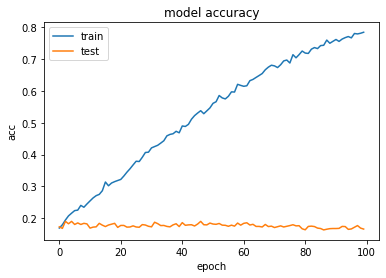

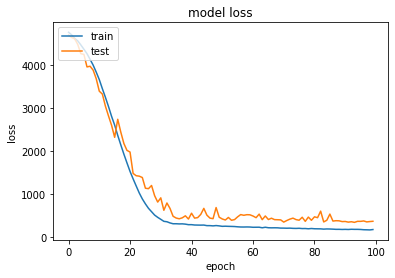

In [ ]:
# Visualize training history
from keras.models import Sequential
from keras.layers import Dense
import matplotlib.pyplot as plt
import numpy as np


def show_history(acc,val_acc):
  print(history.history.keys())
  # summarize history for accuracy
  plt.plot(history.history[acc])
  plt.plot(history.history[val_acc])
  plt.title('model accuracy')
  plt.ylabel('acc')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()
  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()


show_history('expression_output_accuracy','val_expression_output_accuracy')

## Fixing overfitting
Vertical flip by data augmentation removed and Dropout added

In [ ]:
dir_data='/content/celeba/img_align_celeba'

In [ ]:
files = np.load('/content/drive/MyDrive/TFG/final_pandas_df.npz',allow_pickle=True)
final_df= pd.DataFrame(files['final_df'], columns=files['columns'])
final_df

,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,000011.jpg,34,1,happy,1,2,Black_Hair
1,000024.jpg,30,1,fear,1,2,Blond_Hair
2,000036.jpg,35,0,fear,0,2,Black_Hair
3,000049.jpg,46,0,sad,0,2,Black_Hair
4,000067.jpg,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...
34870,055037.jpg,43,0,happy,0,3,Gray_Hair
34871,055040.jpg,30,1,happy,1,3,Brown_Hair
34872,055042.jpg,32,1,happy,1,3,Blond_Hair
34873,055044.jpg,30,1,happy,1,3,Black_Hair


In [ ]:
dir_data='/content/celeba/img_align_celeba'


neutral     2069
happy       2051
fear        1981
sad         1677
angry        888
surprise     450
Name: expression, dtype: int64


,index,image_id,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,0,000011.jpg,34,1,happy,1,2,Black_Hair
1,1,000024.jpg,30,1,fear,1,2,Blond_Hair
2,2,000036.jpg,35,0,fear,0,2,Black_Hair
3,3,000049.jpg,46,0,sad,0,2,Black_Hair
4,4,000067.jpg,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...,...,...
9111,34851,055012.jpg,46,0,neutral,0,4,Gray_Hair
9112,34853,055014.jpg,28,0,angry,0,0,Black_Hair
9113,34865,055031.jpg,38,1,happy,1,3,Gray_Hair
9114,34866,055032.jpg,27,0,surprise,0,6,Black_Hair


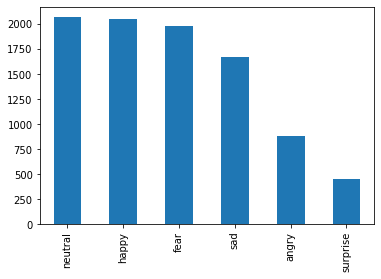

In [ ]:
df_rest = final_df.loc[(final_df.expression=='surprise') | (final_df.expression=='angry')|  (final_df.expression=='sad') | (final_df.hair_color=='Gray_Hair')]
df_rest = df_rest.combine_first(final_df.loc[final_df.expression=='happy'][:1200].copy())
df_rest = df_rest.combine_first(final_df.loc[final_df.expression=='neutral'][:1400].copy())
df_rest = df_rest.combine_first(final_df.loc[final_df.expression=='fear'][:1900].copy())
df_rest = df_rest.drop(df_rest[df_rest.expression=='disgust'].index)
df_rest['expression'].value_counts().plot(kind='bar')
print(df_rest['expression'].value_counts())
df_rest=df_rest.reset_index()
df_rest

# Different data augmentation

In [ ]:
dir_data='/content/celeba/img_align_celeba'

In [ ]:
from PIL import Image
import numpy as np
dir_data='/content/celeba/img_align_celeba'

def obtain_x_y(final_df):
  X, Y = [],[]
  # and you can iterate over this in for loop
  for image_name, categories in zip(final_df['image_id'],final_df[['predicted_age', 'gender', 'expression', 'gender_id',
       'expression_id', 'hair_color']].values):
      image = np.asarray(Image.open(dir_data+"/"+image_name))
      X.append(image)
      Y.append(categories)
  return X, Y

In [ ]:
X,Y = obtain_x_y(df_rest)

In [ ]:
len(X), len(Y)

(9116, 9116)

In [ ]:
angry_df= df_rest.loc[df_rest.expression == 'angry']
X_angry,Y_angry = obtain_x_y(angry_df)

In [ ]:
scales = np.arange(0.9, 1, 0.1)
brightness_values = [ 0.5, 1.7]
shifts = [ 0.2]
rotations = np.arange(0, 2)
au_x_angry, au_y_angry = augment_data(X_angry, scales, rotations, brightness_values, shifts, Y_angry)

1776


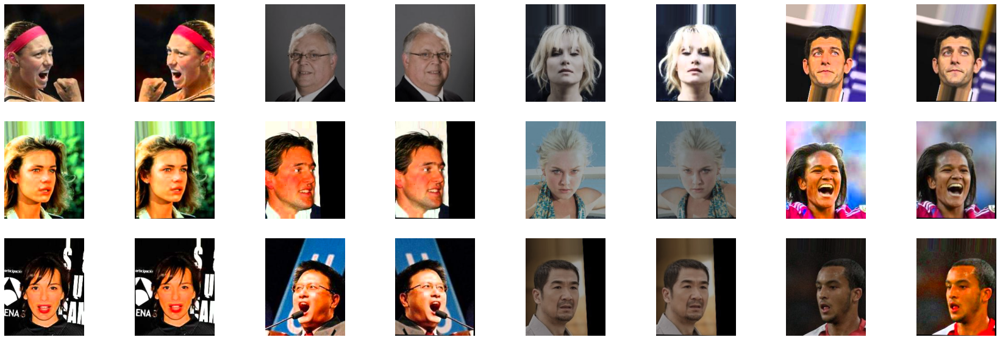

In [ ]:
print(len(au_x_angry))
num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)

for index,image in enumerate(au_x_angry[12:36]):
    rows = 3
    cols=8
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.imshow(image) 

In [ ]:
X_total_np = np.concatenate((X, au_x_angry), axis=0)
Y_total_np = np.concatenate((Y, au_y_angry), axis=0)
len(X_total_np), len(Y_total_np)

(10892, 10892)

In [ ]:
suprise_df= df_rest.loc[df_rest.expression == 'surprise']
X_surprise,Y_surprise = obtain_x_y(suprise_df)

In [ ]:
scales = np.arange(0.9, 1, 0.1)
rotations = np.arange(1, 3)
brightness_values = [ 0.5, 1.7]
shifts = [ 0.2]
au_x_surprise, au_y_surprise = augment_data(X_surprise, scales, rotations, brightness_values, shifts, Y_surprise)

900


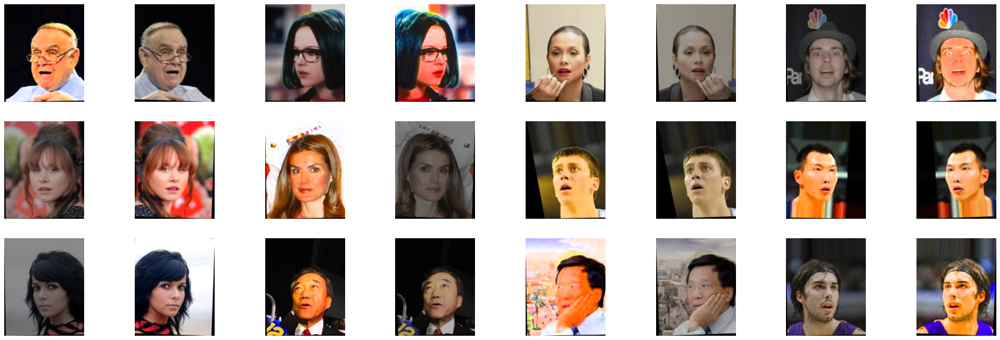

In [ ]:
print(len(au_x))
num=0
figsize = (30,10)
fig = plt.figure(figsize=figsize)

for index,image in enumerate(au_x[12:36]):
    rows = 3
    cols=8
    plt.subplot(rows,cols,index+1)
    plt.axis('off')
    plt.imshow(image) 

In [ ]:
X_total_np_final = np.concatenate((X_total_np, au_x_surprise), axis=0)
Y_total_np_final = np.concatenate((Y_total_np, au_y_surprise), axis=0)

In [ ]:
X_total_np_final.shape, Y_total_np_final.shape

((11792, 218, 178, 3), (11792, 6))

In [ ]:
columns = 'predicted_age	gender	expression	gender_id	expression_id	hair_color'.split()
df_train = pd.DataFrame(Y_total_np_final, columns=columns)
df_train

,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,34,1,happy,1,2,Black_Hair
1,30,1,fear,1,2,Blond_Hair
2,35,0,fear,0,2,Black_Hair
3,46,0,sad,0,2,Black_Hair
4,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...
11787,31,1,surprise,1,5,Brown_Hair
11788,24,0,surprise,0,5,Black_Hair
11789,24,0,surprise,0,5,Black_Hair
11790,27,0,surprise,0,6,Black_Hair


In [ ]:
np.savez('/content/drive/MyDrive/TFG/df_train_flip_hor.npz', df_train)

In [ ]:
Y_total_np_final.shape, X_total_np_final.shape

((11792, 6), (11792, 218, 178, 3))

In [ ]:
np.savez('/content/drive/MyDrive/TFG/X_total_np_flip_hor.npz', X_total_np_final)
np.savez('/content/drive/MyDrive/TFG/Y_total_np_flip_hor.npz', Y_total_np_final)

In [ ]:
X_total_np = np.load('/content/drive/MyDrive/TFG/X_total_np_flip_hor.npz', allow_pickle=True)['arr_0']
Y_total_np = np.load('/content/drive/MyDrive/TFG/Y_total_np_flip_hor.npz', allow_pickle=True)['arr_0']
#df_train = np.load('/content/drive/MyDrive/TFG/df_train_flip_hor.npz', allow_pickle=True)['arr_0']

In [ ]:
X_total_np.shape, Y_total_np.shape

((11792, 218, 178, 3), (11792, 6))

In [ ]:
columns = 'predicted_age	gender	expression	gender_id	expression_id	hair_color'.split()
df_train=pd.DataFrame(Y_total_np, columns=columns)
df_train

,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,34,1,happy,1,2,Black_Hair
1,30,1,fear,1,2,Blond_Hair
2,35,0,fear,0,2,Black_Hair
3,46,0,sad,0,2,Black_Hair
4,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...
11787,31,1,surprise,1,5,Brown_Hair
11788,24,0,surprise,0,5,Black_Hair
11789,24,0,surprise,0,5,Black_Hair
11790,27,0,surprise,0,6,Black_Hair


# Train the model

In [ ]:
import numpy as np 
import pandas as pd
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
#dataset_folder_name = dir_data
TRAIN_TEST_SPLIT = 0.7
dataset_dict = {
    # 'angry', 'fear', 'happy', 'neutral', 'sad', 'surprise'
    'expression_id': {
        0: 'angry',  
        1: 'fear', 
        2: 'happy', 
        3: 'neutral',
        4: 'sad',
        5: 'surprise'
    },
    'gender_id': {
        0: 0,
        1: 1
    },
    'hair_id': {
        0: 'Black_Hair',
        1: 'Brown_Hair',
        2: 'Blond_Hair',
        3: 'Gray_Hair',
    }
}
dataset_dict['gender_alias'] = dict((g, i) for i, g in dataset_dict['gender_id'].items())
dataset_dict['expression_alias'] = dict((r, i) for i, r in dataset_dict['expression_id'].items())
dataset_dict['hair_alias'] = dict((r, i) for i, r in dataset_dict['hair_id'].items())

In [ ]:
from tensorflow.keras.utils import to_categorical
from PIL import Image
TRAIN_TEST_SPLIT = 0.7
class FaceDataGenerator():
    """
    Data generator for the CELEBA dataset. This class should be used when training our Keras multi-output model.
    """
    def __init__(self, images_array, df):
        self.images_array = images_array
        self.df = df
        
    def generate_split_indexes(self):
        p = np.random.permutation(len(self.df))
        train_up_to = int(len(self.df) * TRAIN_TEST_SPLIT)
        train_idx = p[:train_up_to]
        test_idx = p[train_up_to:]
        train_up_to = int(train_up_to * TRAIN_TEST_SPLIT)
        train_idx, valid_idx = train_idx[:train_up_to], train_idx[train_up_to:]
        
        # converts alias to id
        self.df['gender_id'] = self.df['gender'].map(lambda gender: dataset_dict['gender_alias'][gender])
        self.df['expression_id'] = self.df['expression'].map(lambda race: dataset_dict['expression_alias'][race])
        self.df['hair_id'] = self.df['hair_color'].map(lambda hair: dataset_dict['hair_alias'][hair])
        self.max_age = self.df['predicted_age'].max()

        #print(train_idx)
        
        return train_idx, valid_idx, test_idx
    
    def preprocess_image(self, img_path):
        """
        Used to perform some minor preprocessing on the image before inputting into the network.
        """
        im = Image.open(img_path)
        im = im.resize((WIDTH, HEIGHT))
        im = np.array(im) / 255.0
        
        return im
        
    def generate_images(self, image_idx, is_training, batch_size=16):
        """
        Used to generate a batch with images when training/testing/validating our Keras model.
        """
        
        # arrays to store our batched data
        images, ages, facial_expressions, genders, hairs = [], [], [], [], []
        while True:
            for idx in image_idx:
                person = self.df.iloc[idx]
                
                age = person['predicted_age']
                expression = person['expression_id']
                gender = person['gender_id']
                hair = person['hair_id']
                #file = person['image_id']
                
                #im = self.preprocess_image(image_dir+file)
                
                #ages.append(age / self.max_age)
                ages.append(age)
                facial_expressions.append(to_categorical(expression, len(dataset_dict['expression_id'])))
                genders.append(to_categorical(gender, len(dataset_dict['gender_id'])))
                hairs.append(to_categorical(hair, len(dataset_dict['hair_id'])))
                images.append(self.images_array[idx])
                #print(facial_expressions)
                # yielding condition
                if len(images) >= batch_size:
                    
                    yield np.array(images), [np.array(ages), np.array(facial_expressions), np.array(genders), np.array(hairs)]
                    images, ages, facial_expressions, genders, hairs = [], [], [], [], []
                    
            if not is_training:
                break

HEIGHT = 178
WIDTH = 218                
data_generator = FaceDataGenerator(X_total_np, df_train)
train_idx, valid_idx, test_idx = data_generator.generate_split_indexes() 

In [ ]:
from keras.models import Model
#from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import Conv2D
from keras.layers.convolutional import MaxPooling2D
from keras.layers.core import Activation
from keras.layers.core import Dropout
from keras.layers.core import Lambda
from keras.layers.core import Dense
from keras.layers import Flatten
from keras.layers import Input
import tensorflow as tf
class MultiOutputModel():
    """
    Used to generate our multi-output model. This CNN contains three branches, one for age, other for 
    sex and another for facial expression. Each branch contains a sequence of Convolutional Layers that is defined
    on the make_default_hidden_layers method.
    """
    def make_default_hidden_layers(self, inputs):
        """
        Used to generate a default set of hidden layers. The structure used in this network is defined as:
        
        Conv2D -> BatchNormalization -> Pooling -> Dropout
        """
        x = Conv2D(16, (3, 3), padding="same")(inputs)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(3, 3))(x)
        x = Dropout(0.25)(x)
        x = Conv2D(32, (3, 3), padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(2, 2))(x)
        x = Dropout(0.25)(x)
        x = Conv2D(32, (3, 3), padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(2, 2))(x)
        x = Dropout(0.25)(x)
        return x
    def build_expression_branch(self, inputs, num_facial_expressions):
        """
        Used to build the expression branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_facial_expressions)(x)
        x = Activation("softmax", name="expression_output")(x)
        return x

    def build_hair_branch(self, inputs, num_facial_expressions):
        """
        Used to build the expression branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_facial_expressions)(x)
        x = Activation("softmax", name="hair_output")(x)
        return x
    def build_gender_branch(self, inputs, num_genders=2):
        """
        Used to build the gender branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = Lambda(lambda c: tf.image.rgb_to_grayscale(c))(inputs)
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_genders)(x)
        x = Activation("sigmoid", name="gender_output")(x)
        return x
    def build_age_branch(self, inputs):   
        """
        Used to build the age branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(1)(x)
        x = Activation("linear", name="age_output")(x)
        return x
    def assemble_full_model(self, width, height, num_facial_expressions):
        """
        Used to assemble our multi-output model CNN.
        """
        input_shape = (height, width, 3)
        inputs = Input(shape=input_shape)
        age_branch = self.build_age_branch(inputs)
        expression_branch = self.build_expression_branch(inputs, num_facial_expressions)
        gender_branch = self.build_gender_branch(inputs)
        hair_branch = self.build_hair_branch(inputs, 4)
        model = Model(inputs=inputs,
                     outputs = [age_branch, expression_branch, gender_branch, hair_branch],
                     name="face_net")
        return model
    
model = MultiOutputModel().assemble_full_model(WIDTH, HEIGHT, num_facial_expressions=len(['angry',  'fear', 'happy', 'neutral', 'sad', 'surprise']))

In [ ]:
#from keras.optimizers import Adam
init_lr = 1e-4
epochs = 100
opt = Adam(lr=init_lr, decay=init_lr / epochs)
model.compile(optimizer=opt, 
              loss={
                  'age_output': 'mse', 
                  'expression_output': 'categorical_crossentropy', 
                  'gender_output': 'binary_crossentropy',
                  'hair_output': 'categorical_crossentropy'},
              loss_weights={
                  'age_output': 4., 
                  'expression_output': 1.5, 
                  'gender_output': 0.1,
                  'hair_output': 1.5},
              metrics={
                  'age_output': 'mae', 
                  'expression_output': 'accuracy',
                  'gender_output': 'accuracy',
                  'hair_output': 'accuracy'})

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
from keras.callbacks import ModelCheckpoint
batch_size = 32
valid_batch_size = 32
train_gen = data_generator.generate_images(train_idx, is_training=True, batch_size=batch_size)
valid_gen = data_generator.generate_images(valid_idx, is_training=True, batch_size=valid_batch_size)

In [ ]:
len(valid_idx)//32

77

In [ ]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

early_stop = EarlyStopping(monitor='val_loss', patience = 3)
checkpoint = ModelCheckpoint('face_descriptor_model.h5', monitor = 'val_accuracy', save_best_only=True)

history = model.fit_generator(train_gen,
                    steps_per_epoch=len(train_idx)//batch_size,
                    epochs=epochs,
                    callbacks = [early_stop, checkpoint],
                    validation_data=valid_gen,
                    validation_steps=len(valid_idx)//valid_batch_size)

Epoch 1/100


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  # This is added back by InteractiveShellApp.init_path()


 10/180 [>.............................] - ETA: 10:52 - loss: 5033.1523 - age_output_loss: 1256.4269 - expression_output_loss: 2.8150 - gender_output_loss: 1.0228 - hair_output_loss: 2.0797 - age_output_mae: 34.4014 - expression_output_accuracy: 0.1594 - gender_output_accuracy: 0.4969 - hair_output_accuracy: 0.2781

KeyboardInterrupt: ignored

# Data  augmentation with Keras

In [ ]:
X_np = np.asarray(X, dtype=np.float)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """Entry point for launching an IPython kernel.


In [ ]:
Y_np = np.asarray(Y)

In [ ]:
X_np.shape, Y_np.shape

((9116, 218, 178, 3), (9116, 6))

In [ ]:
np.savez('/content/drive/MyDrive/TFG/Y_np.npz', Y_np)
np.savez('/content/drive/MyDrive/TFG/X_np.npz', X_np)

In [ ]:
Y_np=np.load('/content/drive/MyDrive/TFG/Y_np.npz', allow_pickle=True)['arr_0']
X_np=np.load('/content/drive/MyDrive/TFG/X_np.npz', allow_pickle=True)['arr_0']

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
from keras.preprocessing.image import ImageDataGenerator
# create data generator
datagen = ImageDataGenerator()

# create iterator
it = datagen.flow(X_np, Y_np, batch_size=1)

In [ ]:
# example of horizontal shift image augmentation
from numpy import expand_dims
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import ImageDataGenerator
from matplotlib import pyplot

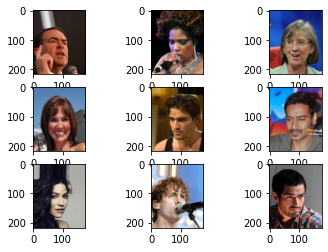

In [ ]:


# generate samples and plot
for i in range(9):
  # define subplot
  pyplot.subplot(330 + 1 + i)
  # generate batch of images
  batch = it.next()
  # convert to unsigned integers for viewing
  image = batch[0].astype('uint8')
  image = np.squeeze(image)
  # plot raw pixel data
  pyplot.imshow(image)
# show the figure
pyplot.show()

In [ ]:
columns = 'predicted_age	gender	expression	gender_id	expression_id	hair_color'.split()
df = pd.DataFrame(Y_np, columns=columns)
df

,predicted_age,gender,expression,gender_id,expression_id,hair_color
0,34,1,happy,1,2,Black_Hair
1,30,1,fear,1,2,Blond_Hair
2,35,0,fear,0,2,Black_Hair
3,46,0,sad,0,2,Black_Hair
4,29,0,sad,0,2,Brown_Hair
...,...,...,...,...,...,...
9111,46,0,neutral,0,4,Gray_Hair
9112,28,0,angry,0,0,Black_Hair
9113,38,1,happy,1,3,Gray_Hair
9114,27,0,surprise,0,6,Black_Hair


In [ ]:
new_df=pd.DataFrame()
ages,facial_expressions,genders,hairs=[],[],[],[]
train_up_to = int(len(df) * TRAIN_TEST_SPLIT)
for i, person in list(df.iterrows())[:train_up_to]:
                
  age = person['predicted_age']
  expression = person['expression_id']
  gender = person['gender_id']
  hair = person['hair_id']
  #file = person['image_id']
  
  #im = self.preprocess_image(image_dir+file)
  
  #ages.append(age / self.max_age)
  ages.append(age)
  facial_expressions.append(to_categorical(expression, len(dataset_dict['expression_id'])))
  genders.append(to_categorical(gender, len(dataset_dict['gender_id'])))
  hairs.append(to_categorical(hair, len(dataset_dict['hair_id'])))

In [ ]:
Y_categorical= [np.array(ages), np.array(facial_expressions), np.array(genders), np.array(hairs)]

In [ ]:
pd.DataFrame(Y_categorical)

,0,1,2,3,4,5,6,7,8,9,...,6371,6372,6373,6374,6375,6376,6377,6378,6379,6380
0,34,30,35,46,29,34,49,31,42,23,...,32,47,26,52,31,47,28,29,32,49
1,"[0.0, 0.0, 1.0, 0.0, 0.0, 0.0]","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[0.0, 0.0, 1.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 1.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 1.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[0.0, 0.0, 0.0, 1.0, 0.0, 0.0]",...,"[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[0.0, 0.0, 1.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0, 1.0]","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 1.0, 0.0, 0.0, 0.0, 0.0]"
2,"[0.0, 1.0]","[0.0, 1.0]","[1.0, 0.0]","[1.0, 0.0]","[1.0, 0.0]","[1.0, 0.0]","[0.0, 1.0]","[0.0, 1.0]","[1.0, 0.0]","[1.0, 0.0]",...,"[0.0, 1.0]","[1.0, 0.0]","[1.0, 0.0]","[1.0, 0.0]","[0.0, 1.0]","[0.0, 1.0]","[0.0, 1.0]","[1.0, 0.0]","[0.0, 1.0]","[0.0, 1.0]"
3,"[1.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 1.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[0.0, 1.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 1.0]","[0.0, 1.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]",...,"[0.0, 1.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 1.0]","[0.0, 0.0, 1.0, 0.0]","[0.0, 1.0, 0.0, 0.0]","[0.0, 1.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[1.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 1.0]"


In [ ]:
import numpy as np 
import pandas as pd
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
#dataset_folder_name = dir_data
TRAIN_TEST_SPLIT = 0.7
dataset_dict = {
    # 'angry', 'fear', 'happy', 'neutral', 'sad', 'surprise'
    'expression_id': {
        0: 'angry',  
        1: 'fear', 
        2: 'happy', 
        3: 'neutral',
        4: 'sad',
        5: 'surprise'
    },
    'gender_id': {
        0: 0,
        1: 1
    },
    'hair_id': {
        0: 'Black_Hair',
        1: 'Brown_Hair',
        2: 'Blond_Hair',
        3: 'Gray_Hair',
    }
}
dataset_dict['gender_alias'] = dict((g, i) for i, g in dataset_dict['gender_id'].items())
dataset_dict['expression_alias'] = dict((r, i) for i, r in dataset_dict['expression_id'].items())
dataset_dict['hair_alias'] = dict((r, i) for i, r in dataset_dict['hair_id'].items())

In [ ]:
from tensorflow.keras.utils import to_categorical
from PIL import Image
TRAIN_TEST_SPLIT = 0.7
class FaceDataGenerator():
    """
    Data generator for the CELEBA dataset. This class should be used when training our Keras multi-output model.
    """
    def __init__(self, images_array, df):
        self.images_array = images_array
        self.df = df
        
    def generate_split_indexes(self):
        p = np.random.permutation(len(self.df))
        train_up_to = int(len(self.df) * TRAIN_TEST_SPLIT)
        train_idx = p[:train_up_to]
        test_idx = p[train_up_to:]
        train_up_to = int(train_up_to * TRAIN_TEST_SPLIT)
        train_idx, valid_idx = train_idx[:train_up_to], train_idx[train_up_to:]
        
        # converts alias to id
        self.df['gender_id'] = self.df['gender'].map(lambda gender: dataset_dict['gender_alias'][gender])
        self.df['expression_id'] = self.df['expression'].map(lambda race: dataset_dict['expression_alias'][race])
        self.df['hair_id'] = self.df['hair_color'].map(lambda hair: dataset_dict['hair_alias'][hair])
        self.max_age = self.df['predicted_age']
        
        return train_idx, valid_idx, test_idx
    
    def preprocess_image(self, img_path):
        """
        Used to perform some minor preprocessing on the image before inputting into the network.
        """
        im = Image.open(img_path)
        im = im.resize((WIDTH, HEIGHT))
        im = np.array(im) / 255.0
        
        return im
        
    def generate_images(self, image_idx, is_training, batch_size=16):
        """
        Used to generate a batch with images when training/testing/validating our Keras model.
        """
        
        # arrays to store our batched data
        images, ages, facial_expressions, genders, hairs = [], [], [], [], []
        while True:
            for idx in image_idx:
                person = self.df.iloc[idx]
                
                age = person['predicted_age']
                expression = person['expression_id']
                gender = person['gender_id']
                hair = person['hair_id']
                #file = person['image_id']
                
                #im = self.preprocess_image(image_dir+file)
                
                #ages.append(age / self.max_age)
                ages.append(age)
                facial_expressions.append(to_categorical(expression, len(dataset_dict['expression_id'])))
                genders.append(to_categorical(gender, len(dataset_dict['gender_id'])))
                hairs.append(to_categorical(hair, len(dataset_dict['hair_id'])))
                images.append(self.images_array[idx])
                
                # yielding condition
                if len(images) >= batch_size:
                    yield np.array(images), [np.array(ages), np.array(facial_expressions), np.array(genders), np.array(hairs)]
                    images, ages, facial_expressions, genders, hairs = [], [], [], [], []
                    
            if not is_training:
                break

HEIGHT = 178
WIDTH = 218                
data_generator = FaceDataGenerator(X_np, df)
train_idx, valid_idx, test_idx = data_generator.generate_split_indexes() 

In [ ]:
HEIGHT = 178
WIDTH = 218  

In [ ]:
from keras.models import Model
#from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import Conv2D
from keras.layers.convolutional import MaxPooling2D
from keras.layers.core import Activation
from keras.layers.core import Dropout
from keras.layers.core import Lambda
from keras.layers.core import Dense
from keras.layers import Flatten
from keras.layers import Input
import tensorflow as tf
class MultiOutputModel():
    """
    Used to generate our multi-output model. This CNN contains three branches, one for age, other for 
    sex and another for facial expression. Each branch contains a sequence of Convolutional Layers that is defined
    on the make_default_hidden_layers method.
    """
    def make_default_hidden_layers(self, inputs):
        """
        Used to generate a default set of hidden layers. The structure used in this network is defined as:
        
        Conv2D -> BatchNormalization -> Pooling -> Dropout
        """
        x = Conv2D(16, (3, 3), padding="same")(inputs)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(3, 3))(x)
        x = Dropout(0.25)(x)
        x = Conv2D(32, (3, 3), padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(2, 2))(x)
        x = Dropout(0.25)(x)
        x = Conv2D(32, (3, 3), padding="same")(x)
        x = Activation("relu")(x)
        x = BatchNormalization(axis=-1)(x)
        x = MaxPooling2D(pool_size=(2, 2))(x)
        x = Dropout(0.25)(x)
        return x
    def build_expression_branch(self, inputs, num_facial_expressions):
        """
        Used to build the expression branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_facial_expressions)(x)
        x = Activation("softmax", name="expression_output")(x)
        return x

    def build_hair_branch(self, inputs, num_facial_expressions):
        """
        Used to build the expression branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_facial_expressions)(x)
        x = Activation("softmax", name="hair_output")(x)
        return x
    def build_gender_branch(self, inputs, num_genders=2):
        """
        Used to build the gender branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = Lambda(lambda c: tf.image.rgb_to_grayscale(c))(inputs)
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(num_genders)(x)
        x = Activation("sigmoid", name="gender_output")(x)
        return x
    def build_age_branch(self, inputs):   
        """
        Used to build the age branch of our face recognition network.
        This branch is composed of three Conv -> BN -> Pool -> Dropout blocks, 
        followed by the Dense output layer.
        """
        x = self.make_default_hidden_layers(inputs)
        x = Flatten()(x)
        x = Dense(128)(x)
        x = Activation("relu")(x)
        x = BatchNormalization()(x)
        x = Dropout(0.5)(x)
        x = Dense(1)(x)
        x = Activation("linear", name="age_output")(x)
        return x
    def assemble_full_model(self, width, height, num_facial_expressions):
        """
        Used to assemble our multi-output model CNN.
        """
        input_shape = (height, width, 3)
        inputs = Input(shape=input_shape)
        age_branch = self.build_age_branch(inputs)
        expression_branch = self.build_expression_branch(inputs, num_facial_expressions)
        gender_branch = self.build_gender_branch(inputs)
        hair_branch = self.build_hair_branch(inputs, 4)
        model = Model(inputs=inputs,
                     outputs = [age_branch, expression_branch, gender_branch, hair_branch],
                     name="face_net")
        return model
    
model = MultiOutputModel().assemble_full_model(WIDTH, HEIGHT, num_facial_expressions=len(['angry',  'fear', 'happy', 'neutral', 'sad', 'surprise']))

In [ ]:
#from keras.optimizers import Adam
init_lr = 1e-4
epochs = 100
opt = Adam(lr=init_lr, decay=init_lr / epochs)
model.compile(optimizer=opt, 
              loss={
                  'age_output': 'mse', 
                  'expression_output': 'categorical_crossentropy', 
                  'gender_output': 'binary_crossentropy',
                  'hair_output': 'categorical_crossentropy'},
              loss_weights={
                  'age_output': 4., 
                  'expression_output': 1.5, 
                  'gender_output': 0.1,
                  'hair_output': 1.5},
              metrics={
                  'age_output': 'mae', 
                  'expression_output': 'accuracy',
                  'gender_output': 'accuracy',
                  'hair_output': 'accuracy'})

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
from keras.callbacks import ModelCheckpoint
batch_size = 32
valid_batch_size = 32
train_gen = data_generator.generate_images(train_idx, is_training=True, batch_size=batch_size)
valid_gen = data_generator.generate_images(valid_idx, is_training=True, batch_size=valid_batch_size)
train_gen

<generator object FaceDataGenerator.generate_images at 0x7f51fe013f50>

In [ ]:
# create data generator
datagen = ImageDataGenerator()

# create iterator
it = datagen.flow(X_np, Y_np)

In [ ]:


callbacks = [
    ModelCheckpoint("./model_checkpoint", monitor='val_loss')
]
history = model.fit_generator(it,
                    steps_per_epoch=200,
                    epochs=epochs,
                    callbacks=callbacks)
                    #validation_data=valid_gen,
                    #validation_steps=len(valid_idx)//valid_batch_size)

# Train the model

In [ ]:
X_total_np = np.load('/content/drive/MyDrive/TFG/X_total_np_flip_hor.npz', allow_pickle=True)['arr_0']
Y_total_np = np.load('/content/drive/MyDrive/TFG/Y_total_np_flip_hor.npz', allow_pickle=True)['arr_0']
df_train = np.load('/content/drive/MyDrive/TFG/df_train_flip_hor.npz', allow_pickle=True)['arr_0']

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
len(Y)*0.7, 6381//batch_size

(6381.2, 199)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  del sys.path[0]


ValueError: ignored